In [1]:
# Import system libraries
import os
import sys

# Import data cleaning libraries
import pandas as pd
import numpy as np
import calendar
from datetime import datetime

# Import machine learning libraries
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold, GridSearchCV

# Import data visualisation libraries
import matplotlib.pyplot as plt 

# Import warning libraries
import warnings
warnings.filterwarnings("ignore")
# Import preprocessing libraries
from preprocessing import cleaning
from preprocessing import feature_engineering
from preprocessing import scaling
from preprocessing import feature_selection
from preprocessing import dim_reduction
from preprocessing import clustering

# Preprocess data
train_path = "Train.csv"
test_path = "Test.csv"
df = cleaning.clean_data(train_path, test_path)
df = feature_engineering.get_features(df)
df = scaling.scale_features(df)
df = feature_selection.select_features(df)
df = dim_reduction.reduce_dim(df)
df = clustering.get_clusters(df)

# Add error predictions
errors = pd.read_csv("Error_Prediction.csv")
df["Error_Prediction"] = errors["Error_Prediction"]

# Add block predictions
block = pd.read_csv("Block_Prediction.csv")
df["Block_Prediction"] = block["Block_Prediction"]

# Add linear error predictions
linear_yield = pd.read_csv("Linear_Yield_Prediction.csv")
df["Linear_Yield_Prediction"] = linear_yield["Linear_Yield_Prediction"]

# Split data into training and test sets
df_train = df[df['Yield'].isna() == False]
df_test = df[df['Yield'].isna() == True]

In [2]:
top_cols = ['SeedlingsPerPit','Ganaura','CropOrgFYM','NoFertilizerAppln','BasalDAP',
            'BasalUrea','2appDaysUrea','Harv_hand_rent','Residue_length',
            'TransplantingIrrigationHours_per_Acre','TransIrriCost_per_Acre',
            'CropOrgFYM_per_Acre','BasalDAP_per_Acre','BasalUrea_per_Acre','1tdUrea_per_Acre',
            'Harv_hand_rent_per_Acre','TpIrrigationCost_Imputed_per_Acre',
            'Days_bw_SowTransp_Harv','Days_bw_Harv_Thresh','NursingDate_ModeDiff',
            'TillageDate_ModeDiff','HarvestDate_ModeDiff','ThreshingDate_ModeDiff',
            'Num_LandPrepMethod','Num_CropbasalFerts','Num_TopDressFert','Latitude',
            'Longitude','CropEstMethod_LineSowingAfterTillage','Threshing_method_machine',
            'Stubble_use_plowed_in_soil','LandPrepMethod_FourWheelTracRotavator_True',
            'LandPrepMethod_WetTillagePuddling_True','NursDetFactor_PreMonsoonShowers_True',
            'NursDetFactor_LabourAvailability_True','FirstTopDressFert_DAP_True',
            'HarvestMonth_November','ThreshingMonth_January','Block_Chehrakala',
            'PCropSolidOrgFertAppMethod_Broadcasting','PCropSolidOrgFertAppMethod_SoilApplied',
            'MineralFertAppMethod_1_Broadcasting','MineralFertAppMethod_1_SoilApplied','PC4',
            'PC10','PC21','top_shapley_k2_label_1']#,'Error_Prediction','Block_Prediction']#,'Linear_Yield_Prediction']

In [3]:
# Split data
outcome_cols = ["Yield","Yield_per_Acre","New_Yield","New_Yield_per_Acre"]
overfit_cols = ['Error_Prediction', 'Block_Prediction', 'Linear_Yield_Prediction']
X, y = df_train.drop(outcome_cols + overfit_cols, axis=1), df_train["New_Yield_per_Acre"]
X = X[top_cols]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [6]:
# A simple Debug

y_train.head()

2181      44.0
416     2640.0
1583    2200.0
217     1787.5
888     1760.0
Name: New_Yield_per_Acre, dtype: float64

In [5]:
X.head()

,SeedlingsPerPit,Ganaura,CropOrgFYM,NoFertilizerAppln,BasalDAP,BasalUrea,2appDaysUrea,Harv_hand_rent,Residue_length,TransplantingIrrigationHours_per_Acre,...,ThreshingMonth_January,Block_Chehrakala,PCropSolidOrgFertAppMethod_Broadcasting,PCropSolidOrgFertAppMethod_SoilApplied,MineralFertAppMethod_1_Broadcasting,MineralFertAppMethod_1_SoilApplied,PC4,PC10,PC21,top_shapley_k2_label_1
0,0.047619,-0.146433,-0.101615,0.333333,-1.106005,1.269875,NaN,-0.636844,1.075102,-0.126266,...,False,False,False,False,True,False,2.257648,0.333528,-0.158362,False
1,0.047619,-0.146433,-0.101615,0.333333,0.569072,0.258647,NaN,-0.633100,-0.756671,-0.126266,...,False,False,False,False,True,False,1.544964,-0.414016,-0.036124,False
2,0.047619,-0.133224,-0.096429,0.333333,-0.659318,-0.752581,NaN,-0.037882,1.075102,-0.065483,...,True,False,False,True,False,True,-3.371456,-1.676866,0.337252,True
3,0.047619,-0.133224,-0.101615,0.333333,-0.435974,-0.449213,NaN,-0.337363,-0.146080,NaN,...,False,False,False,True,True,False,-1.416292,0.264762,1.298361,True
4,0.047619,-0.146433,-0.101615,0.333333,0.569072,2.281103,NaN,-0.636844,-0.756671,-0.108583,...,False,False,False,False,True,False,3.536646,-0.955111,0.017074,False


In [8]:
# First we will use the H2o AutoML library to train the model, 
# We will use three AutoML models in total, and then we will compare the results of the three models to select the best model.
import h2o
from h2o.automl import H2OAutoML

# Start H2O cluster
h2o.init()

# Convert to H2O Frame, We will use the whole dataset for training
h2o_train = h2o.H2OFrame(pd.concat([X_train, y_train], axis=1))
h2o_test = h2o.H2OFrame(pd.concat([X_test, y_test], axis=1))

# Specify target and features
x = h2o_train.columns
y = "New_Yield_per_Acre"
# delete the target column from the list of features
x.remove(y)

# Run H2O AutoML
aml = H2OAutoML(max_runtime_secs=300, 
                stopping_metric='RMSE', 
                sort_metric='RMSE', 
                seed=1, 
                stopping_rounds=5, 
                nfolds=5,
                exploitation_ratio=0.1,
                verbosity='info'
                )
aml.train(x=x, y=y, training_frame=h2o_train)

Checking whether there is an H2O instance running at http://localhost:54321. connected.


H2O_cluster_uptime:,28 secs
H2O_cluster_timezone:,Europe/Berlin
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.44.0.3
H2O_cluster_version_age:,2 months and 16 days
H2O_cluster_name:,H2O_from_python_lmmista_wap266_n5iuox
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,15.68 Gb
H2O_cluster_total_cores:,32
H2O_cluster_allowed_cores:,32
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |
19:33:44.356: Project: AutoML_1_20240307_193344
19:33:44.357: Setting stopping tolerance adaptively based on the training frame: 0.017972128867239735
19:33:44.357: Build control seed: 1
19:33:44.357: training frame: Frame key: AutoML_1_20240307_193344_training_Key_Frame__upload_a9f23a97c4a807b495a49a29b83c43aa.hex    cols: 48    rows: 3096  chunks: 1    size: 361338  checksum: -8584380668072915916
19:33:44.357: validation frame: NULL
19:33:44.357: leaderboard frame: NULL
19:33:44.357: blending frame: NULL
19:33:44.357: response column: New_Yield_per_Acre
19:33:44.357: fold column: null
19:33:44.357: weights column: null
19:33:44.365: Loading execution steps: [{XGBoost : [def_2 (1g, 10w), def_1 (2g, 10w), def_3 (3g, 10w), grid_1 (4g, 90w), lr_search (6g, 30w)]}, {GLM : [def_1 (1g, 

key,value
Stacking strategy,cross_validation
Number of base models (used / total),5/6
# GBM base models (used / total),1/1
# XGBoost base models (used / total),1/1
# DRF base models (used / total),2/2
# DeepLearning base models (used / total),1/1
# GLM base models (used / total),0/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5


In [9]:
# View the AutoML Leaderboard
lb = aml.leaderboard
lb.head(rows=lb.nrows)  # Print all rows instead of default (10 rows)

model_id,rmse,mse,mae,rmsle,mean_residual_deviance
StackedEnsemble_BestOfFamily_7_AutoML_1_20240307_193344,311.666,97135.6,182.756,nan,97135.6
StackedEnsemble_AllModels_6_AutoML_1_20240307_193344,311.748,97186.6,182.563,nan,97186.6
StackedEnsemble_AllModels_4_AutoML_1_20240307_193344,312.534,97677.5,182.497,nan,97677.5
StackedEnsemble_BestOfFamily_5_AutoML_1_20240307_193344,313.139,98056.3,184.39,nan,98056.3
StackedEnsemble_BestOfFamily_6_AutoML_1_20240307_193344,313.42,98232.4,184.526,nan,98232.4
StackedEnsemble_AllModels_5_AutoML_1_20240307_193344,313.464,98259.5,183.237,nan,98259.5
StackedEnsemble_AllModels_3_AutoML_1_20240307_193344,313.993,98591.6,186.486,nan,98591.6
StackedEnsemble_BestOfFamily_4_AutoML_1_20240307_193344,314.578,98959.1,186.778,nan,98959.1
GBM_lr_annealing_selection_AutoML_1_20240307_193344_select_model,315.248,99381.4,190.783,nan,99381.4
StackedEnsemble_AllModels_2_AutoML_1_20240307_193344,316.708,100304,186.404,nan,100304


In [10]:
# Get the best model using the metric
m = aml.get_best_model()

In [11]:
print(m)

Model Details
H2OStackedEnsembleEstimator : Stacked Ensemble
Model Key: StackedEnsemble_BestOfFamily_7_AutoML_1_20240307_193344


Model Summary for Stacked Ensemble: 
key                                        value
-----------------------------------------  ----------------
Stacking strategy                          cross_validation
Number of base models (used / total)       5/6
# GBM base models (used / total)           1/1
# XGBoost base models (used / total)       1/1
# DRF base models (used / total)           2/2
# DeepLearning base models (used / total)  1/1
# GLM base models (used / total)           0/1
Metalearner algorithm                      GLM
Metalearner fold assignment scheme         Random
Metalearner nfolds                         5
Metalearner fold_column
Custom metalearner hyperparameters         None

ModelMetricsRegressionGLM: stackedensemble
** Reported on train data. **

MSE: 24791.470812954976
RMSE: 157.45307495554025
MAE: 86.78831581961225
RMSLE: NaN
Mean Resid

In [12]:
# Get the best model with out a specific algorithm
m = aml.get_best_model(criterion="RMSE")

In [13]:
# Get the best XGBoost model, ranked by logloss
xgb = aml.get_best_model(algorithm="xgboost", criterion="RMSE")

Use the pre-implemented algorithm to explain the model

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_3_AutoML_1_20240307_193344,319.757,102244,182.147,nan,102244,186,0.029052,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_1_20240307_193344,320.21,102535,181.887,nan,102535,177,0.027384,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_1_20240307_193344,321.234,103191,183.041,nan,103191,164,0.021618,StackedEnsemble
StackedEnsemble_AllModels_2_AutoML_1_20240307_193344,321.357,103270,182.517,nan,103270,170,0.023318,StackedEnsemble
GBM_2_AutoML_1_20240307_193344,321.585,103417,187.031,nan,103417,277,0.011293,GBM
StackedEnsemble_BestOfFamily_3_AutoML_1_20240307_193344,322.076,103733,182.38,nan,103733,167,0.027153,StackedEnsemble
StackedEnsemble_BestOfFamily_5_AutoML_1_20240307_193344,322.395,103938,182.496,nan,103938,179,0.028813,StackedEnsemble
GBM_grid_1_AutoML_1_20240307_193344_model_23,322.647,104101,190.847,nan,104101,324,0.013441,GBM
GBM_grid_1_AutoML_1_20240307_193344_model_26,322.767,104178,187.17,nan,104178,246,0.012643,GBM
GBM_3_AutoML_1_20240307_193344,323.128,104411,187.354,0.385995,104411,225,0.010483,GBM


# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

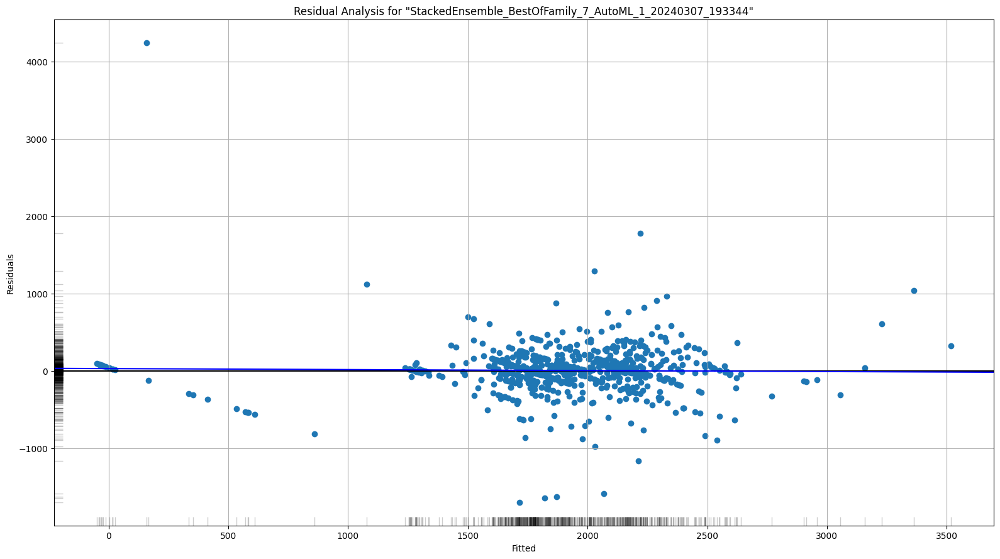

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

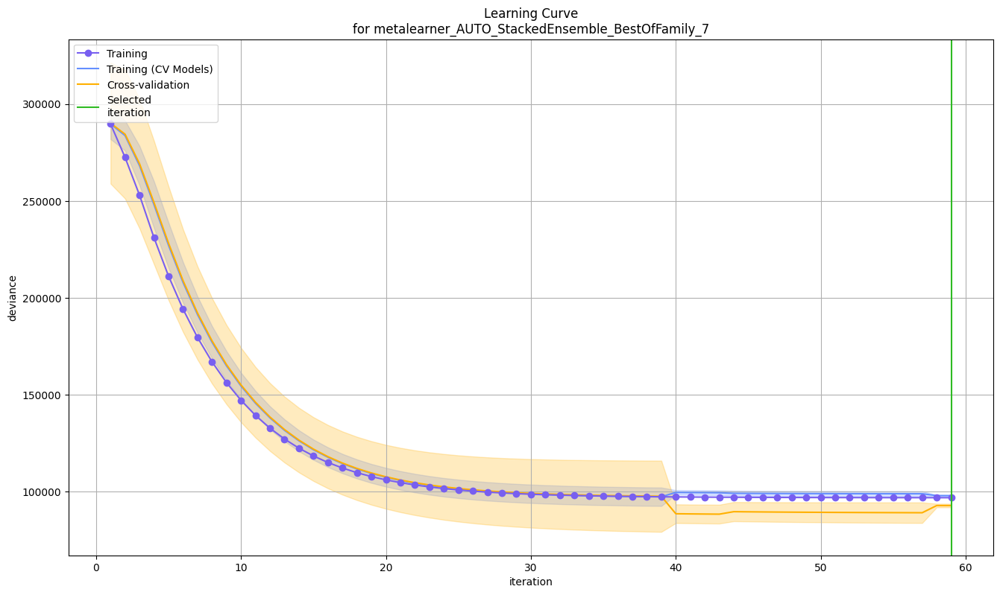

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

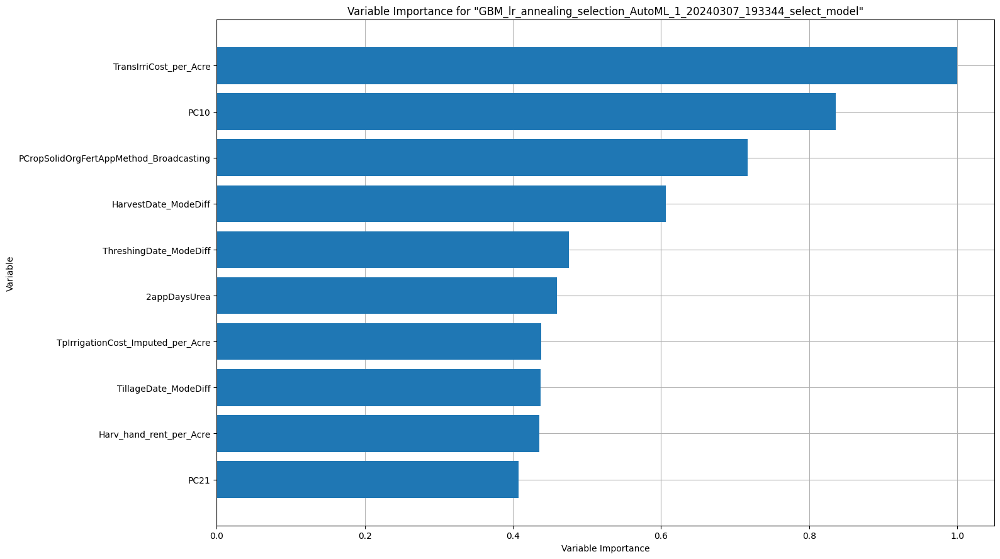

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

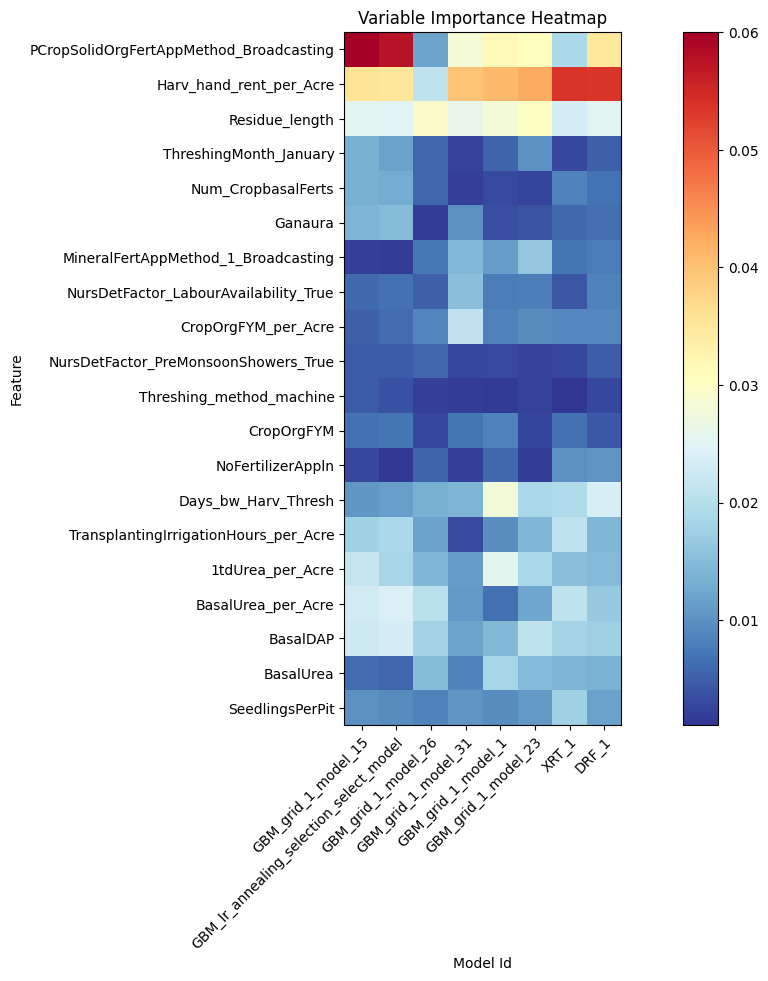

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

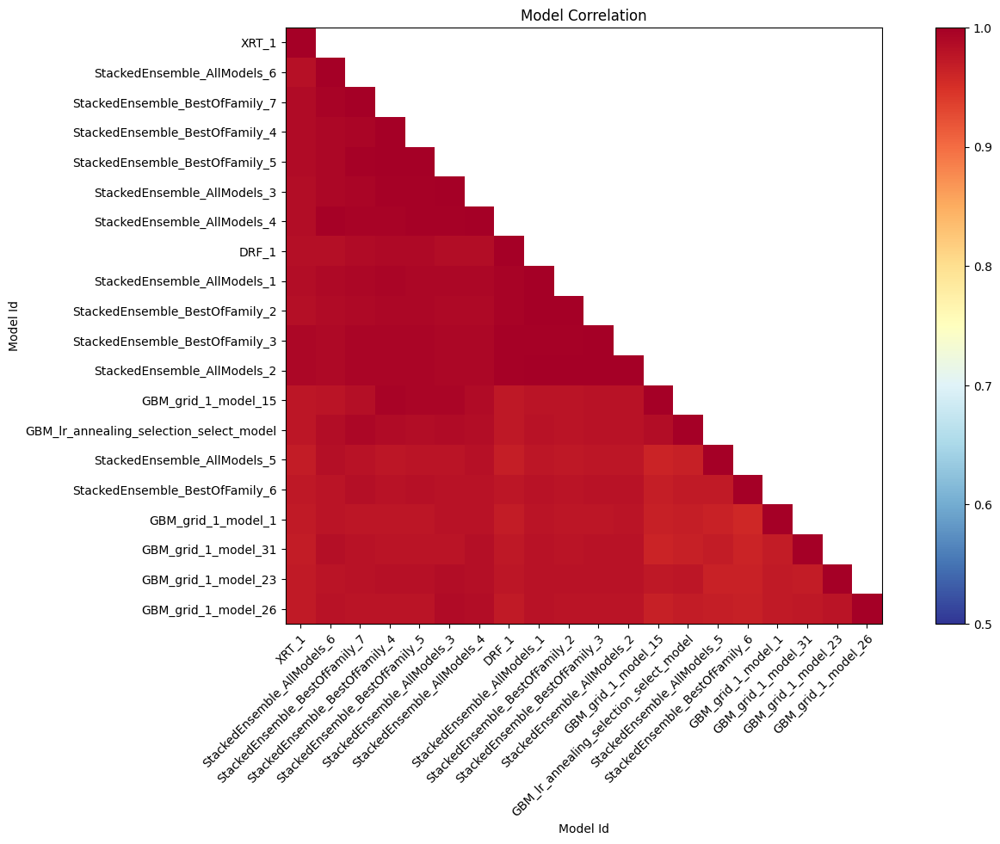

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

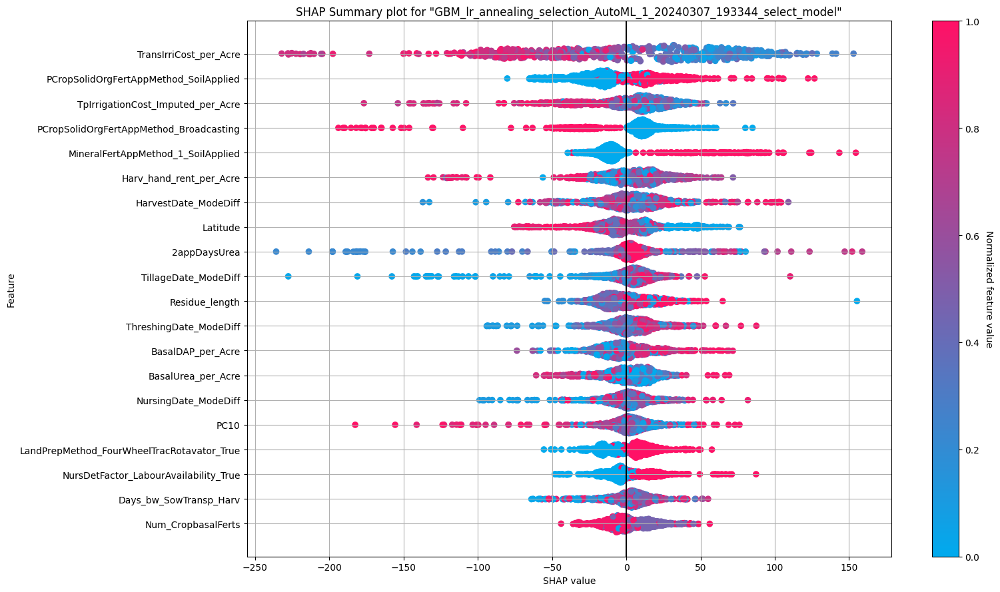

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

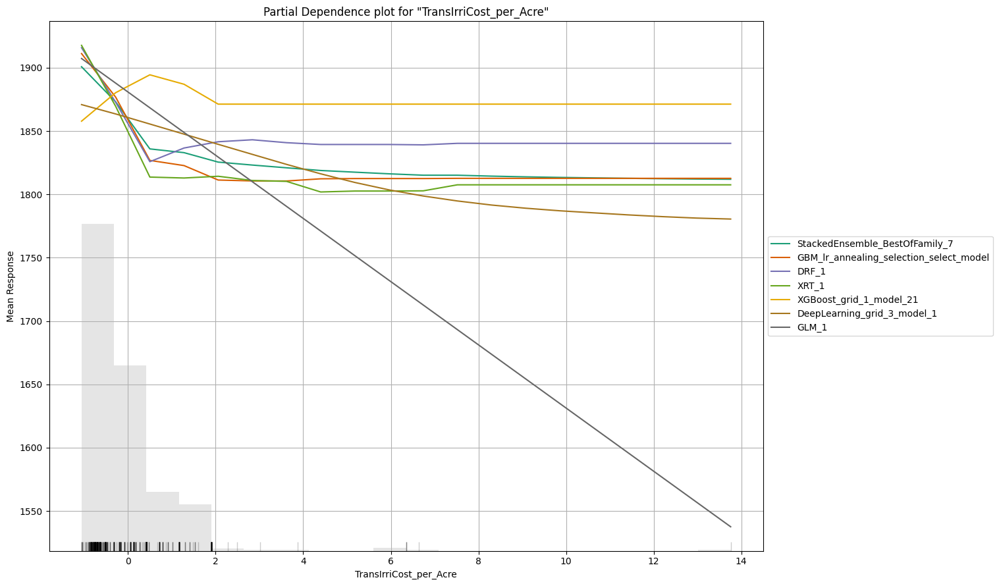

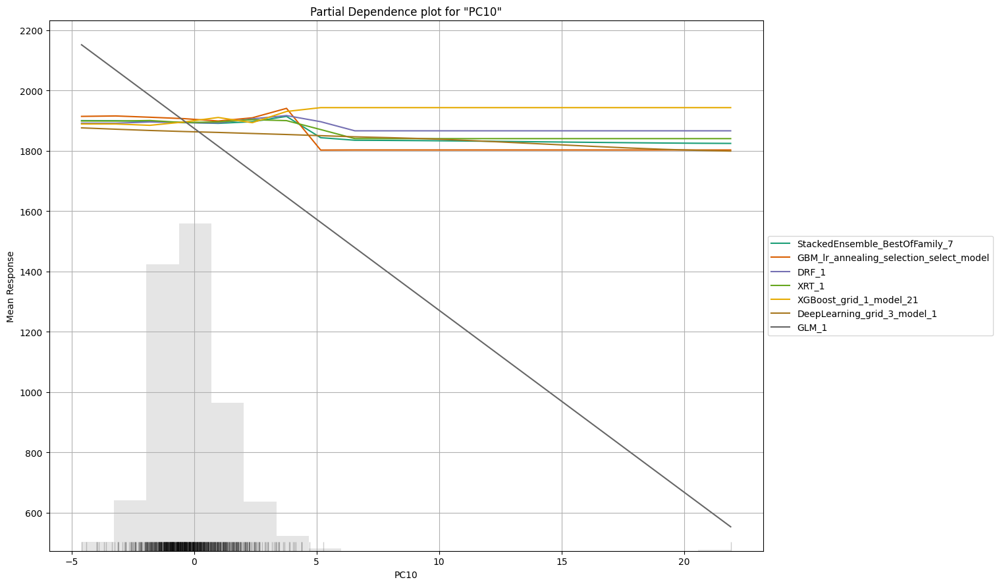

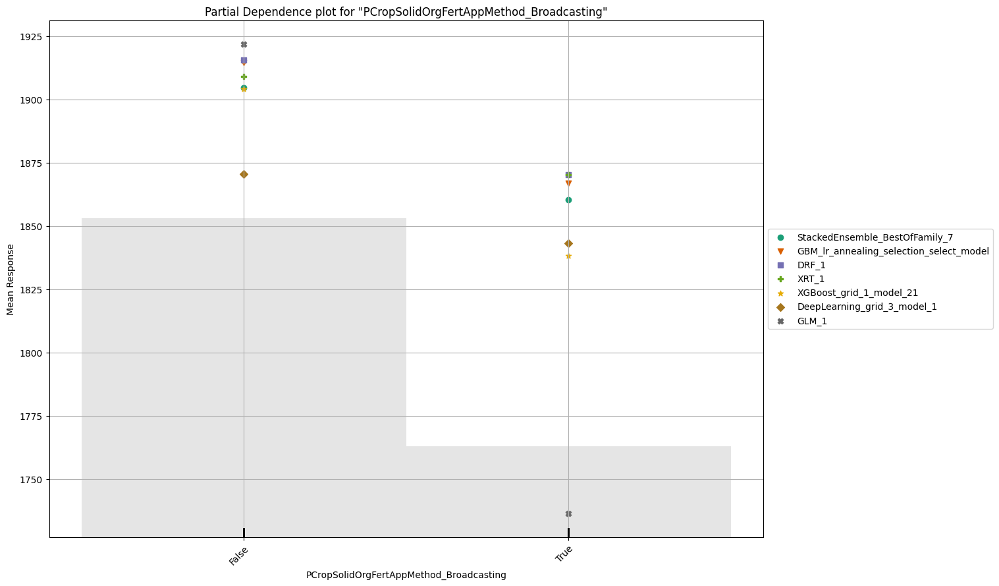

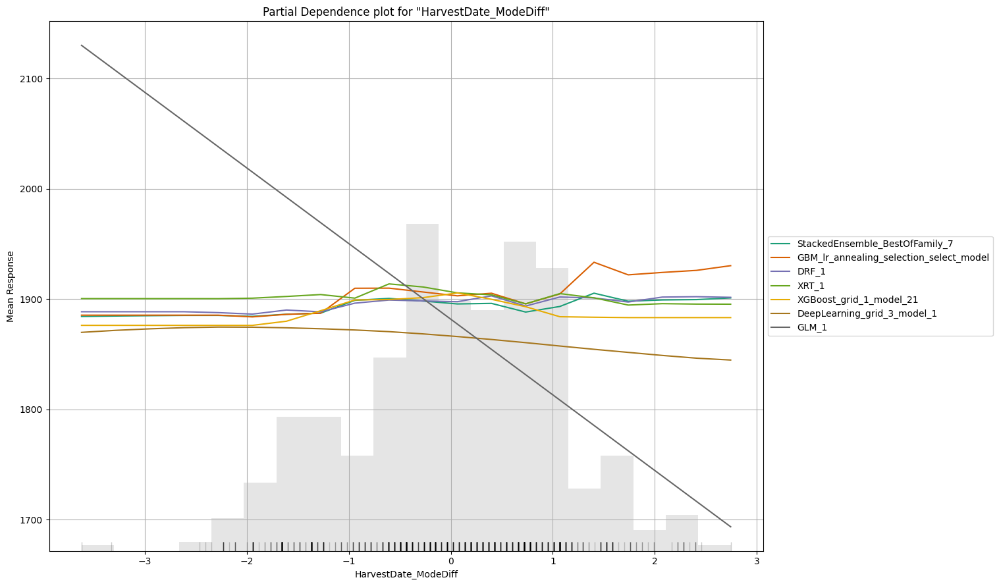

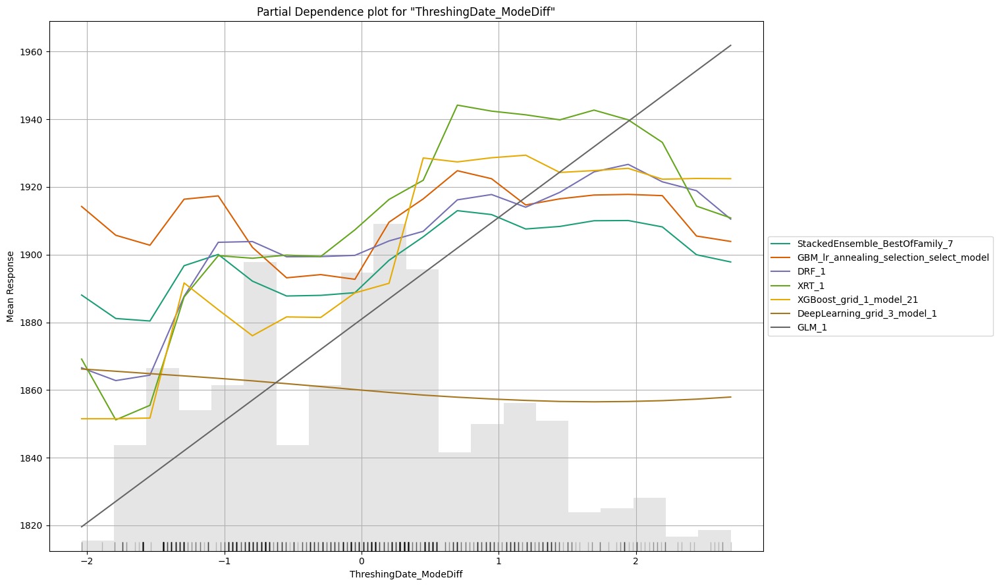

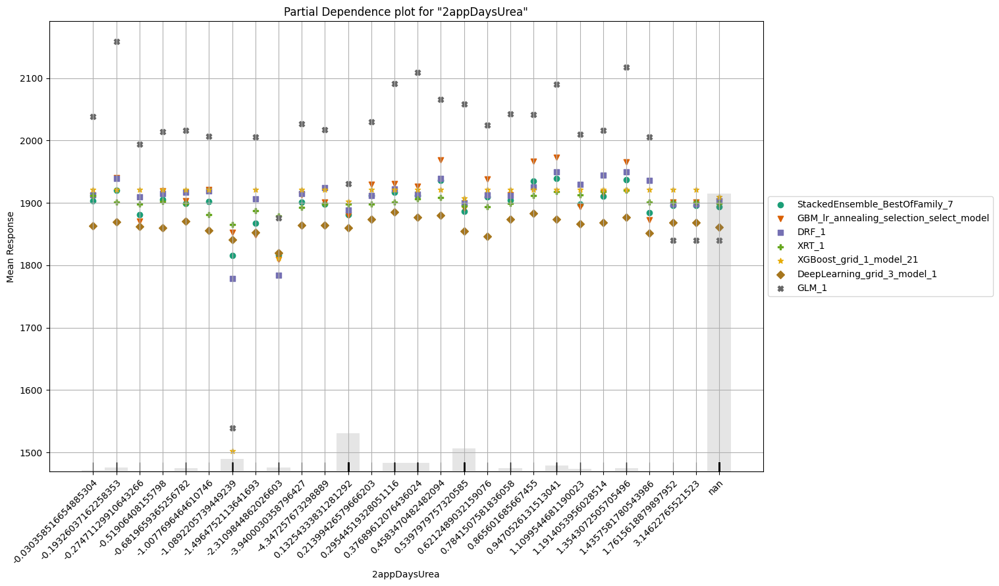

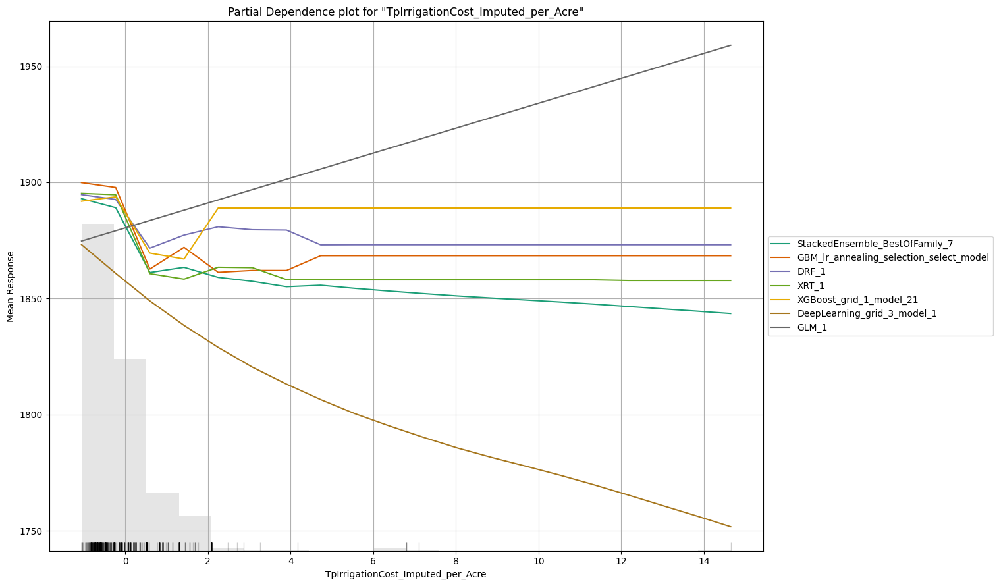

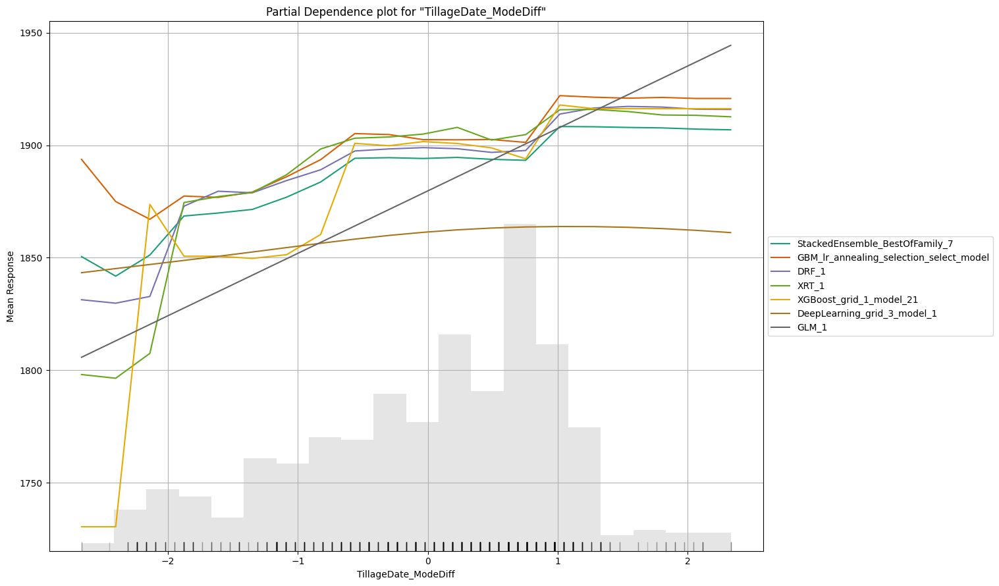

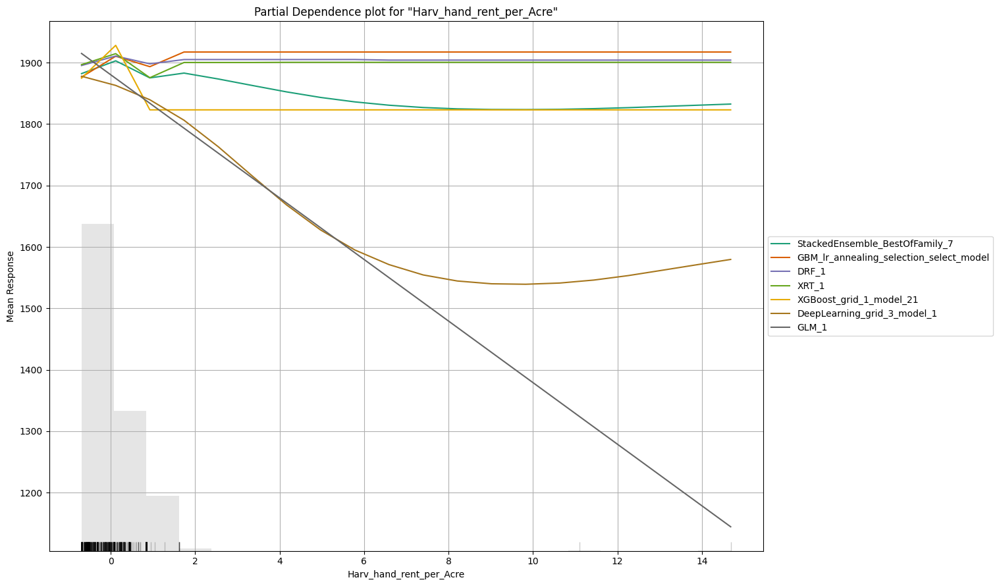

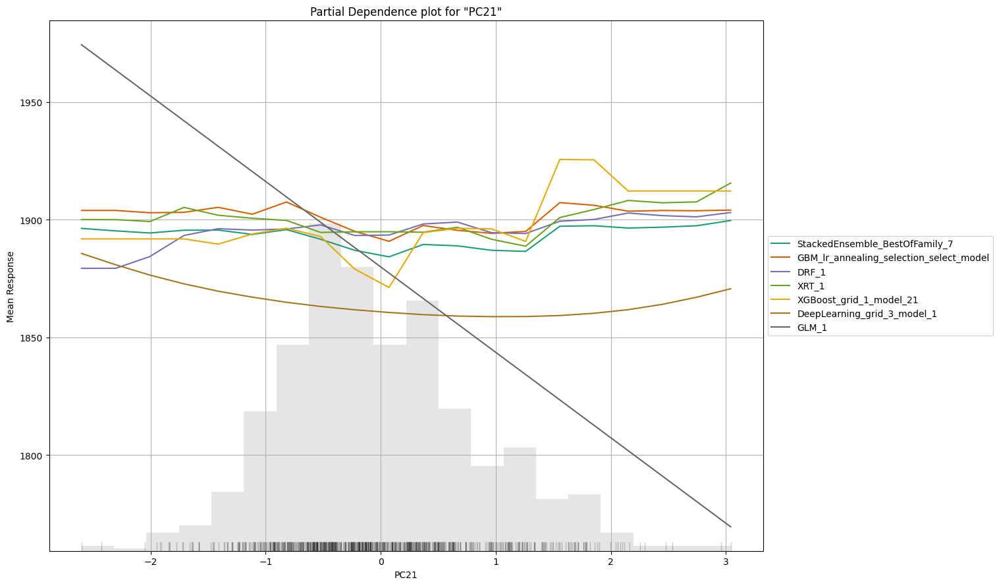

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

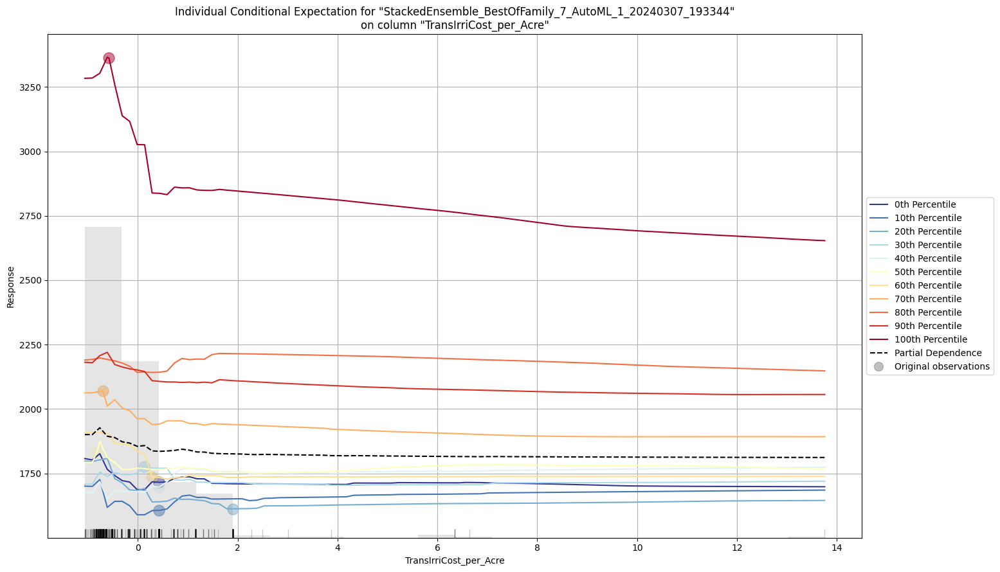

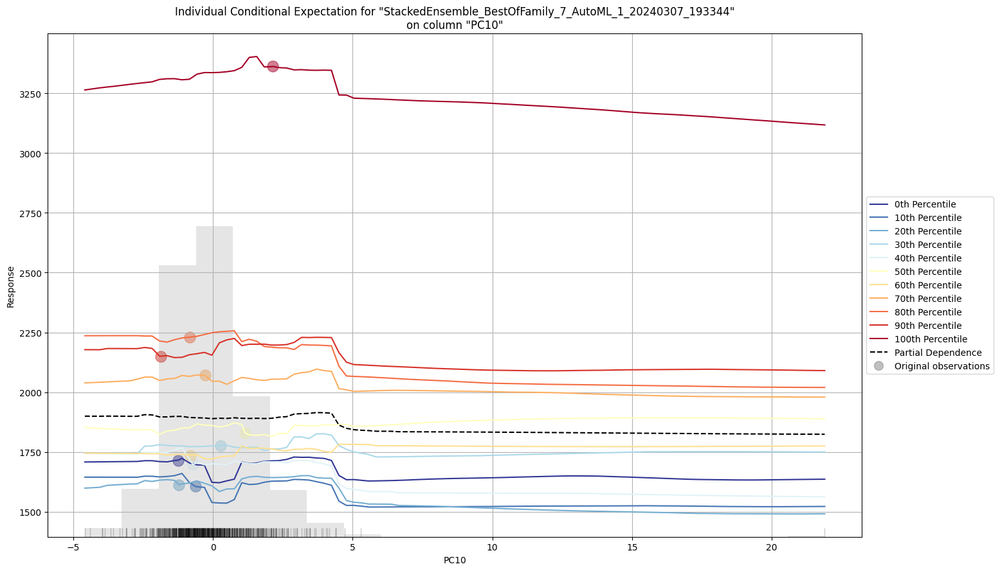

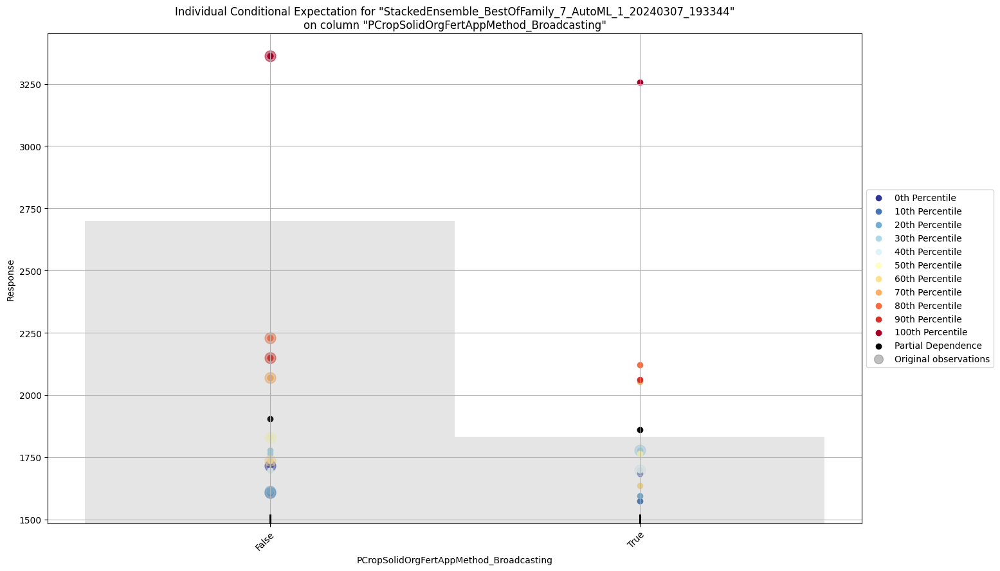

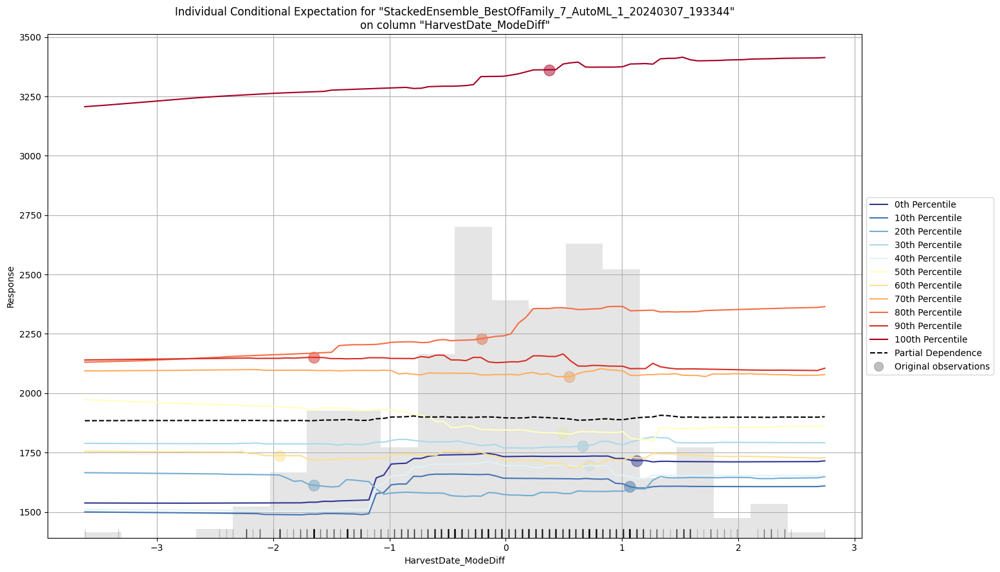

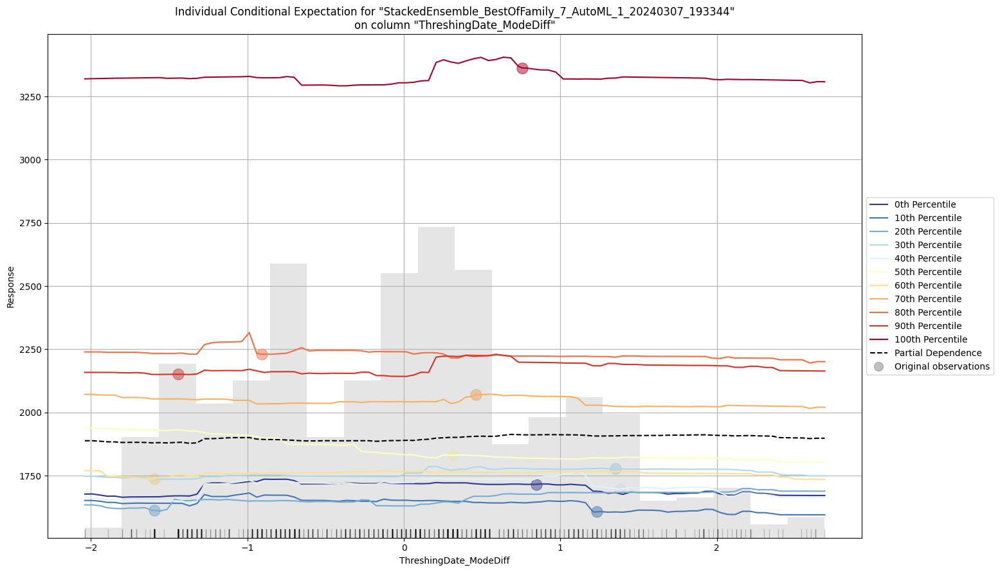

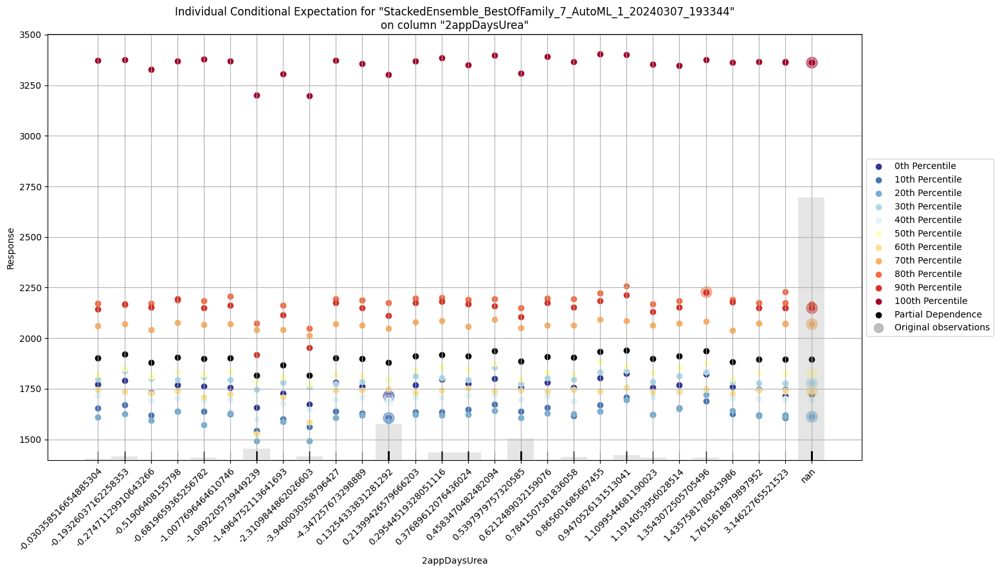

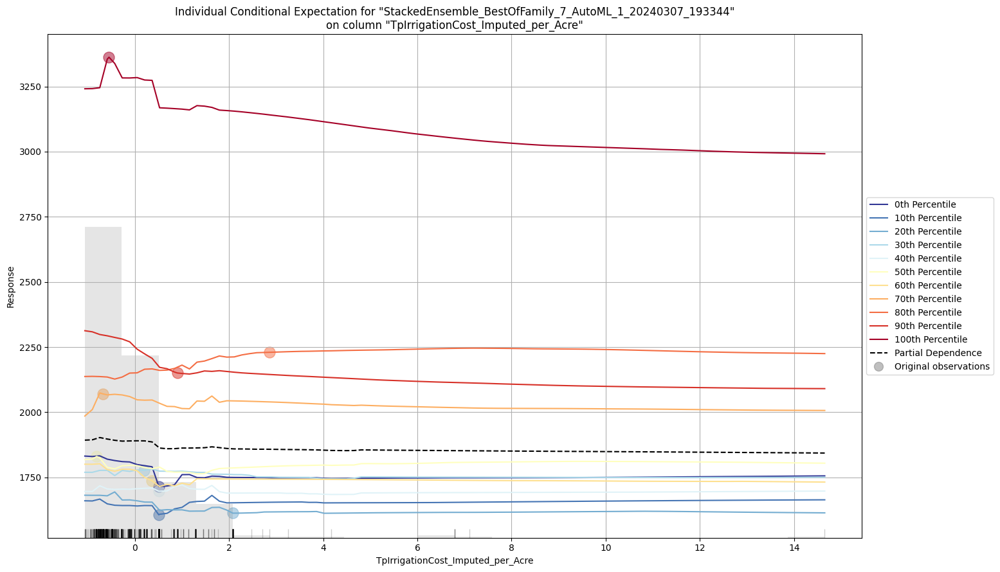

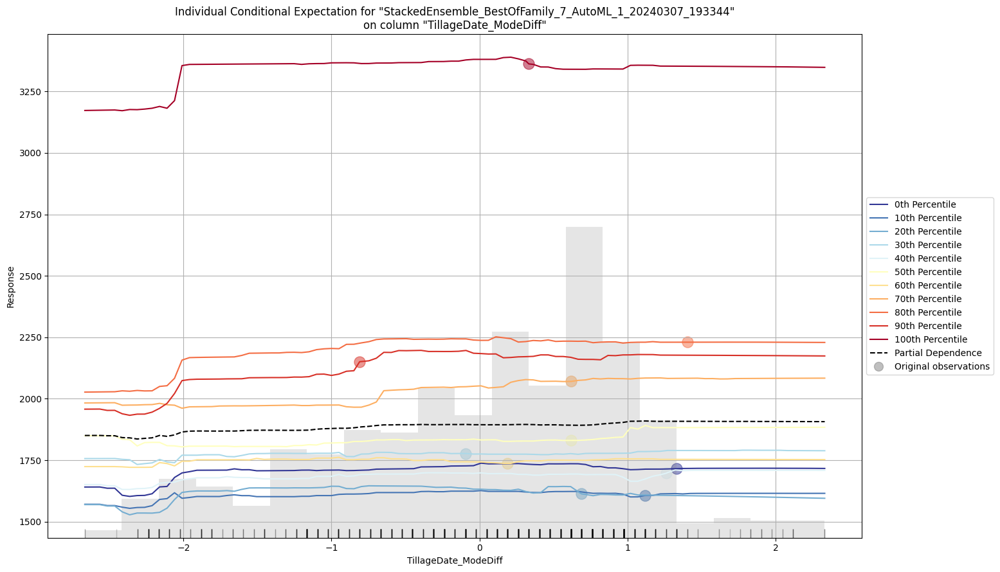

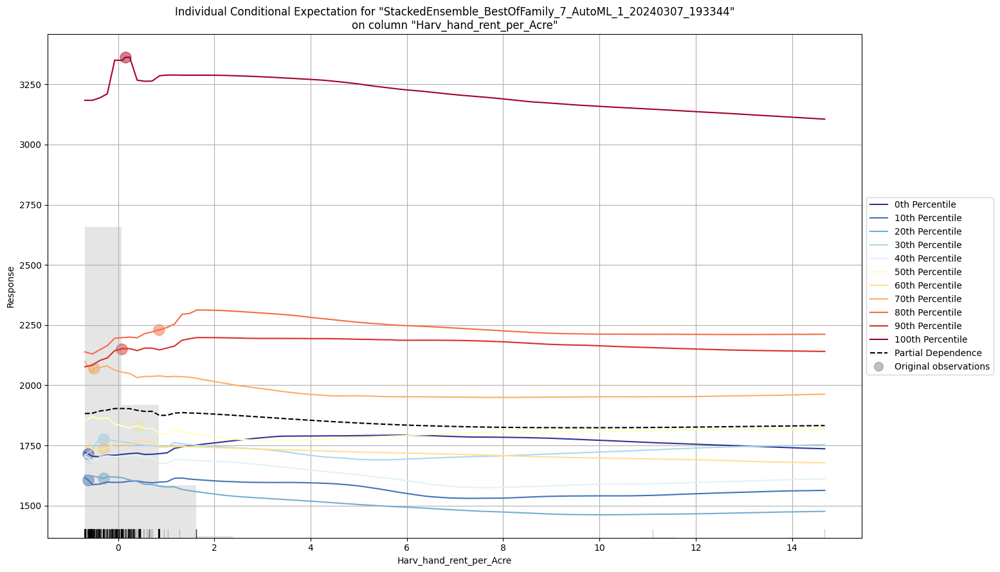

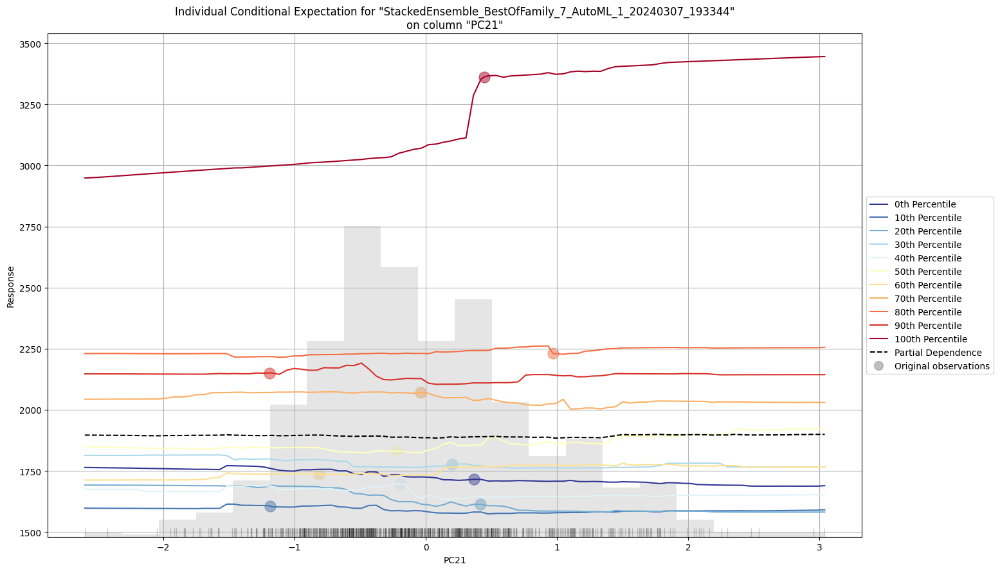

In [16]:
# Use the newly developed method from H2o to explain the result
exa = aml.explain(h2o_test, top_n_features=10)

# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

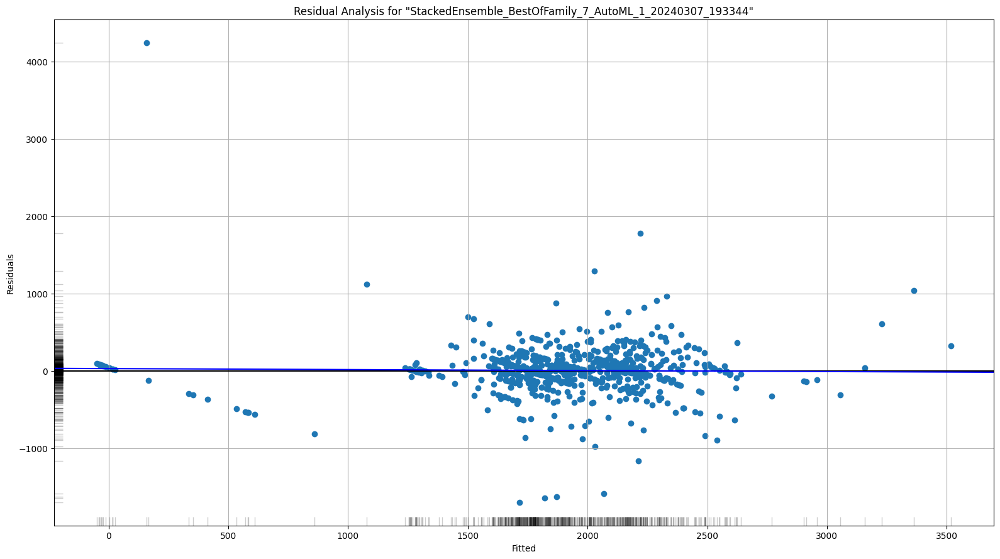

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

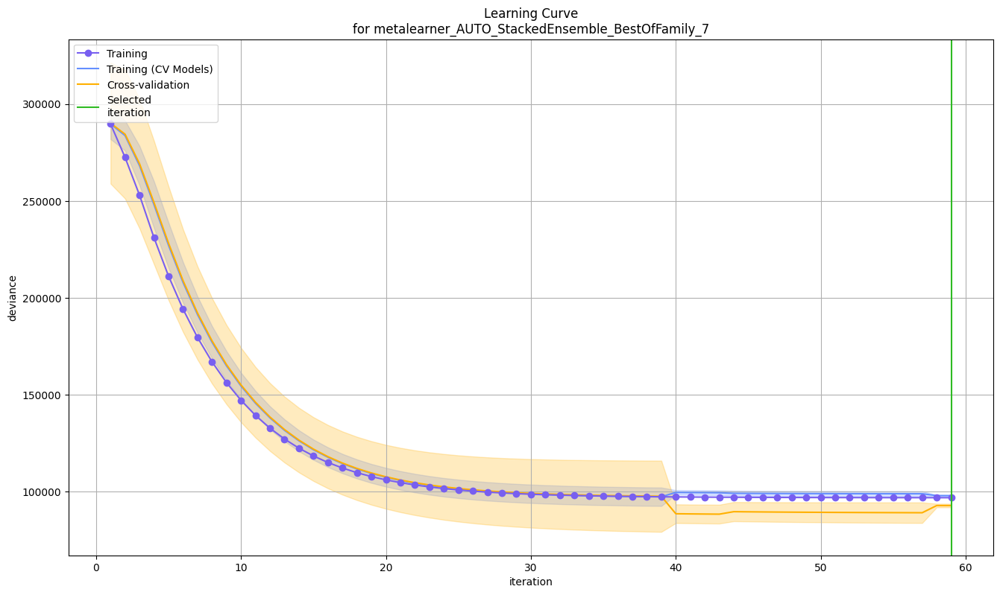

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

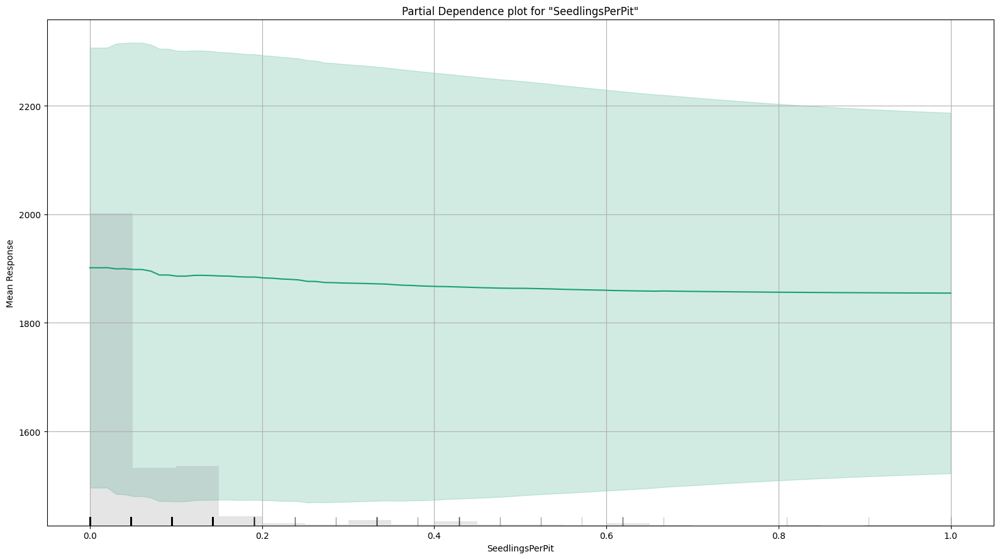

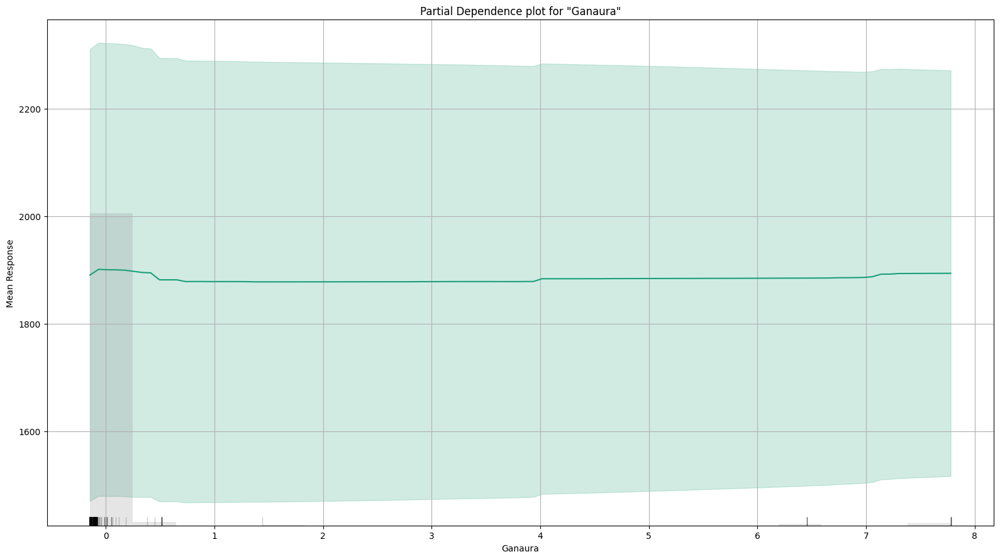

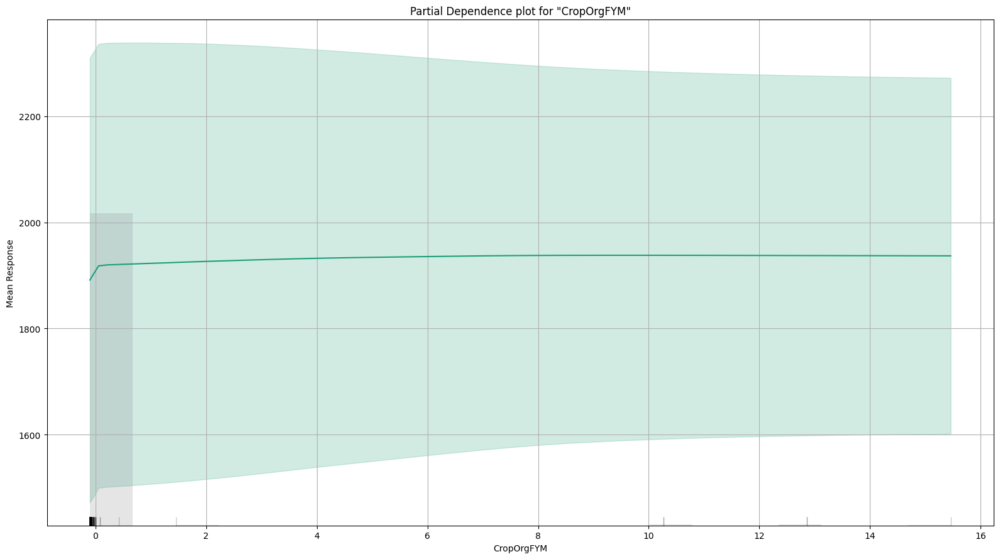

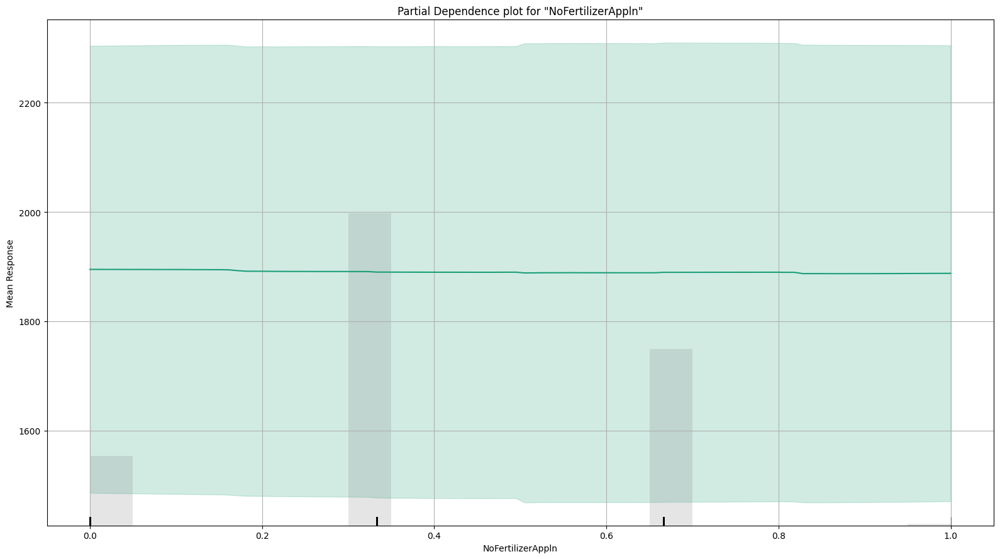

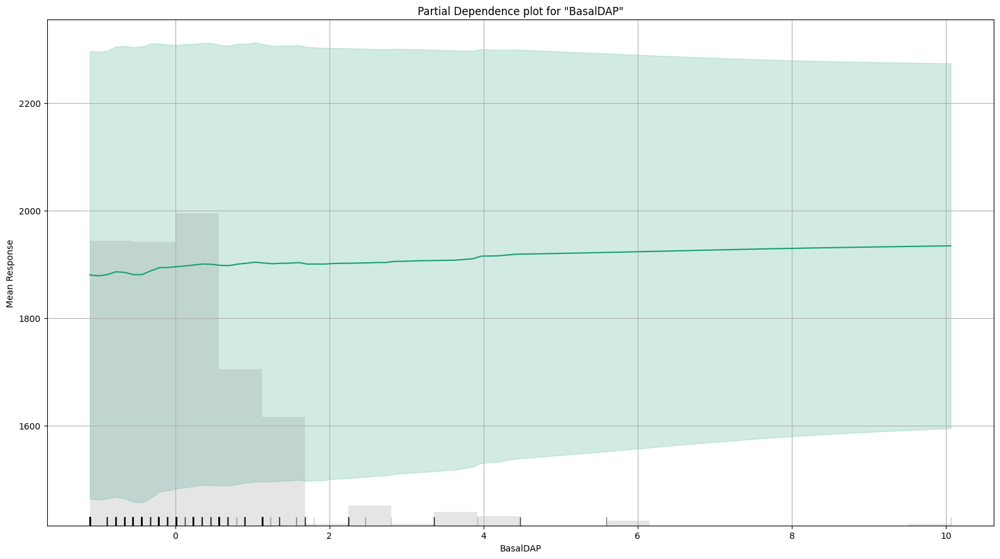

...

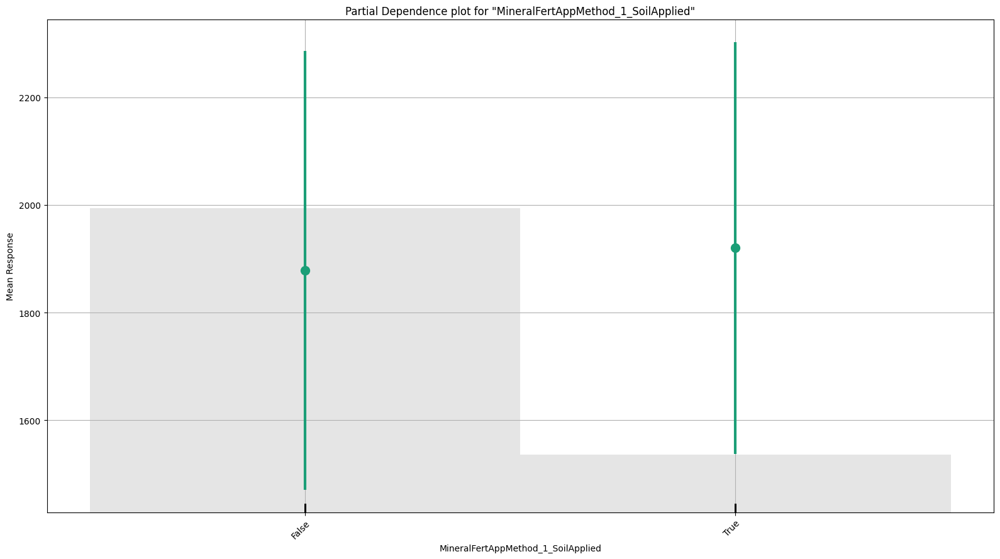

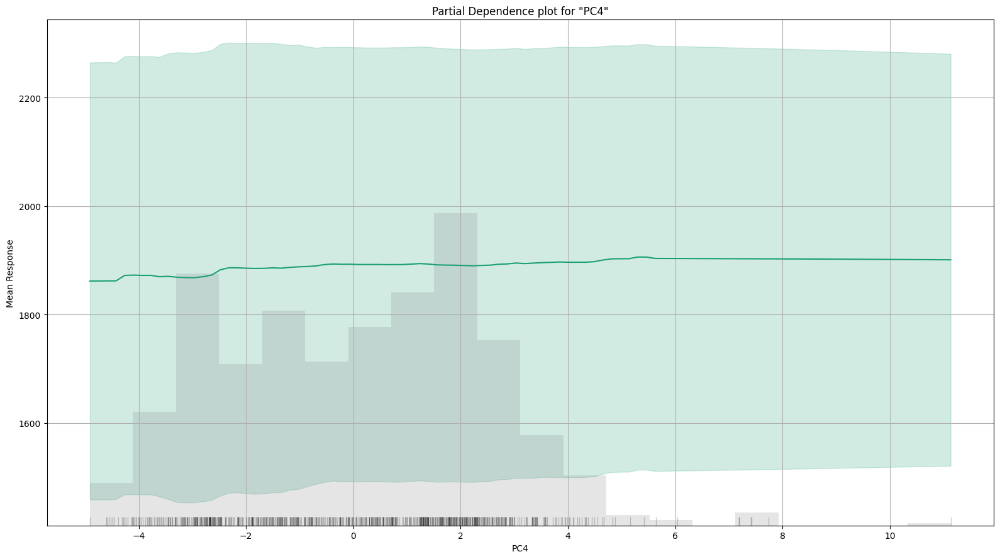

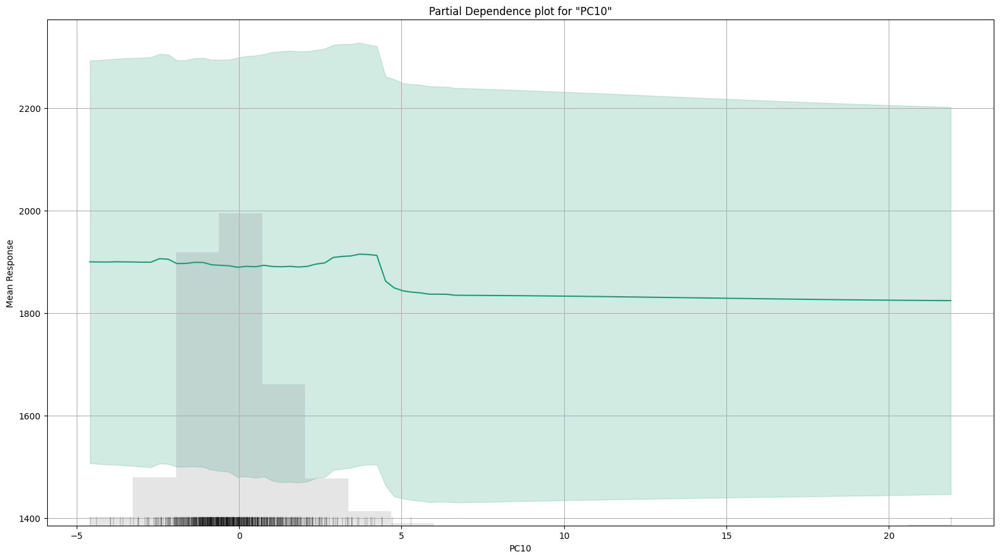

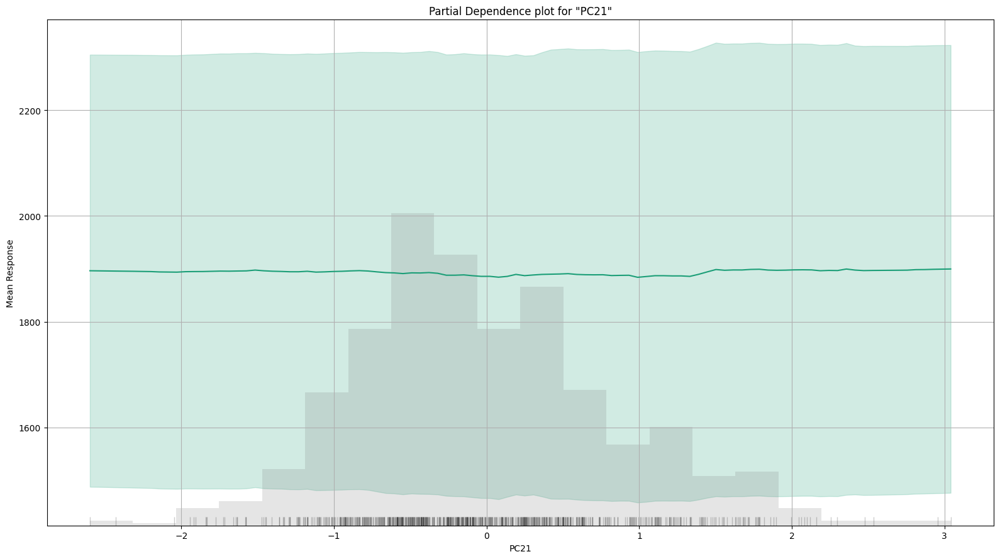

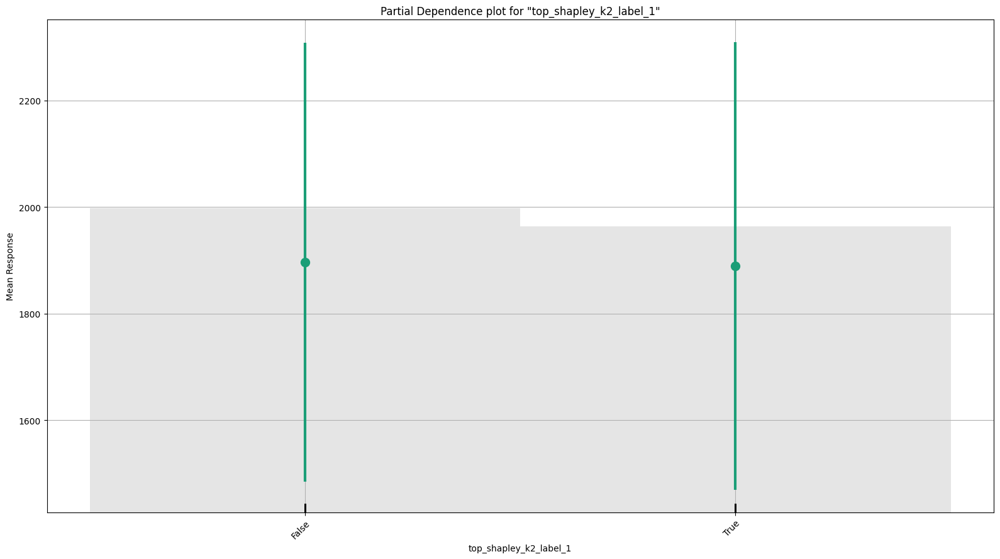

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

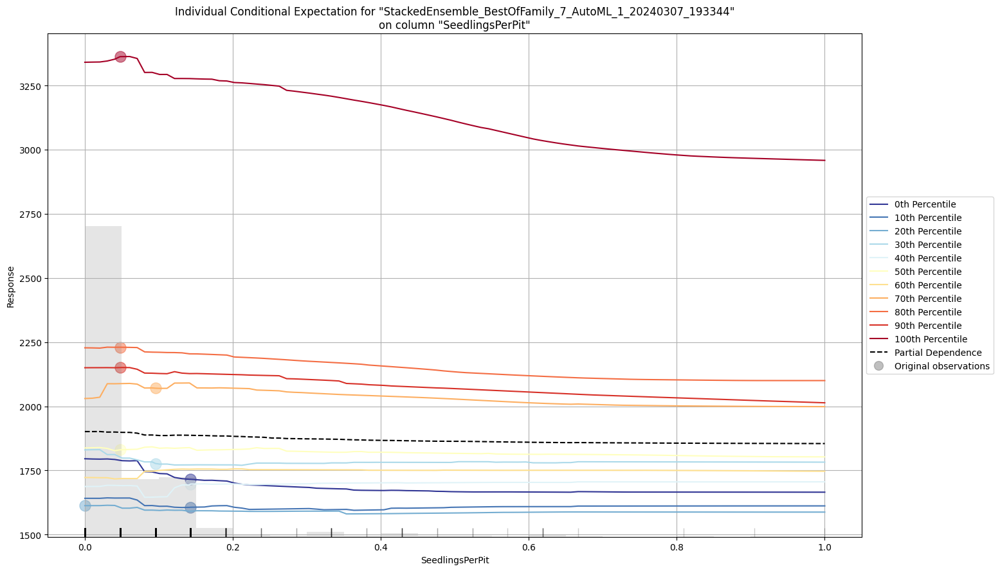

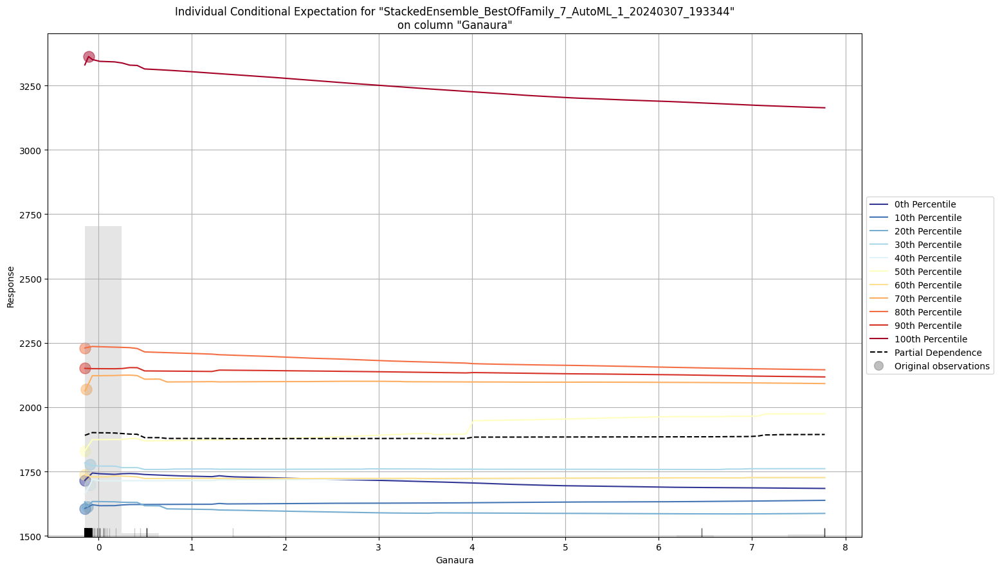

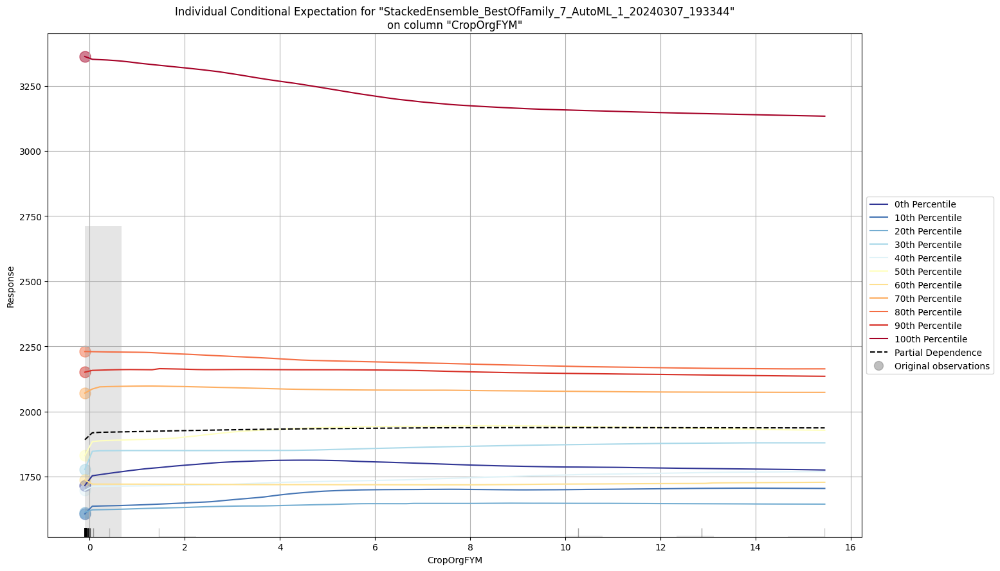

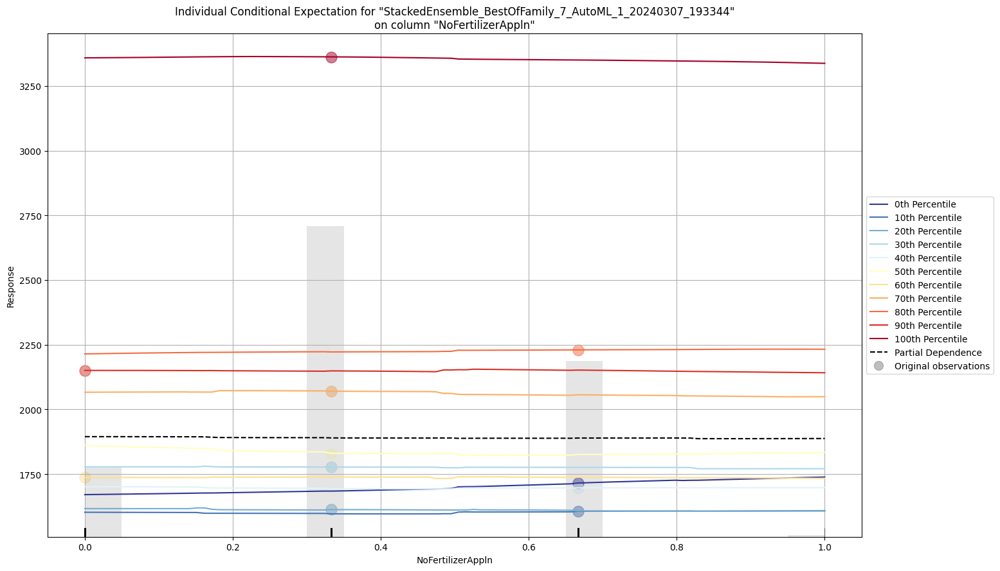

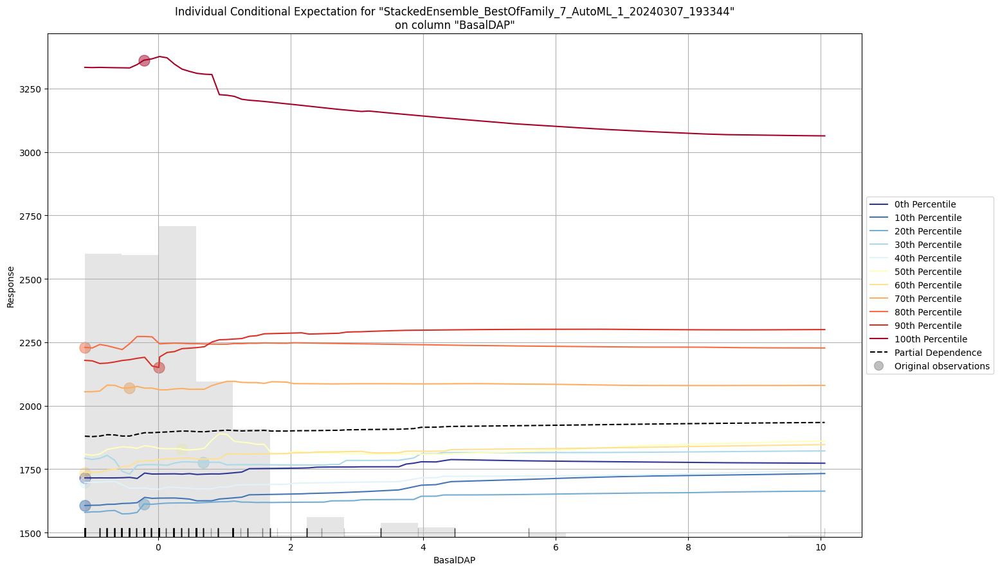

...

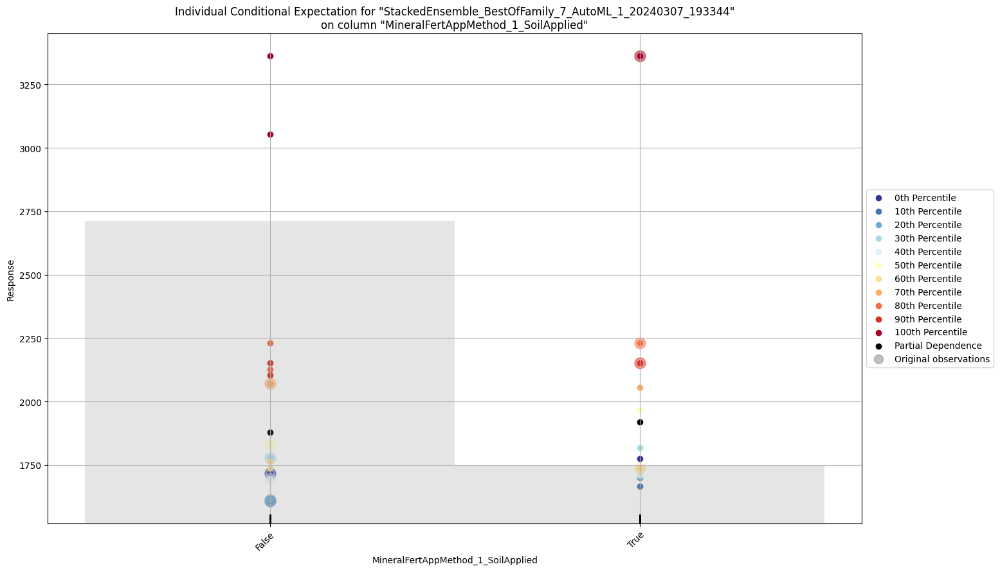

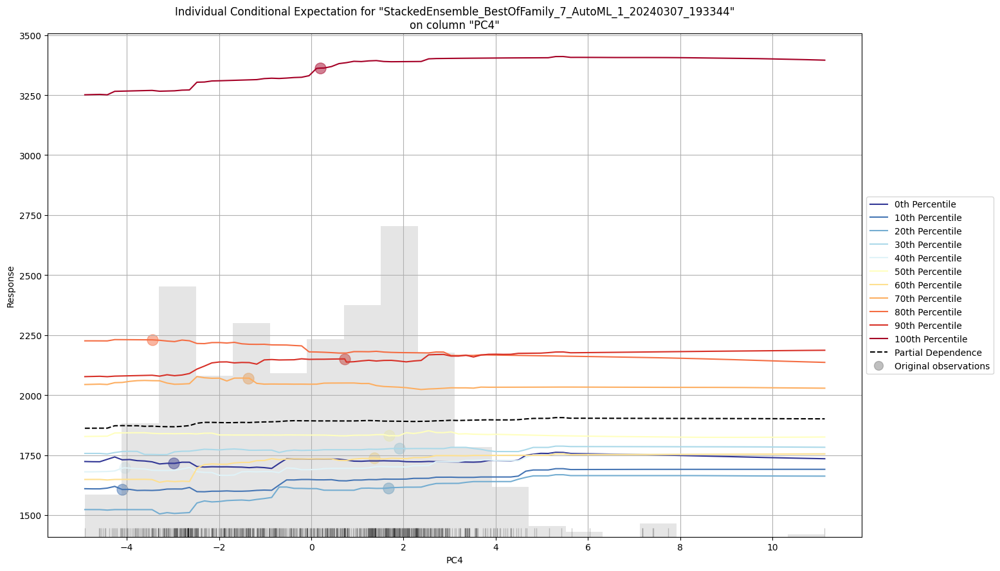

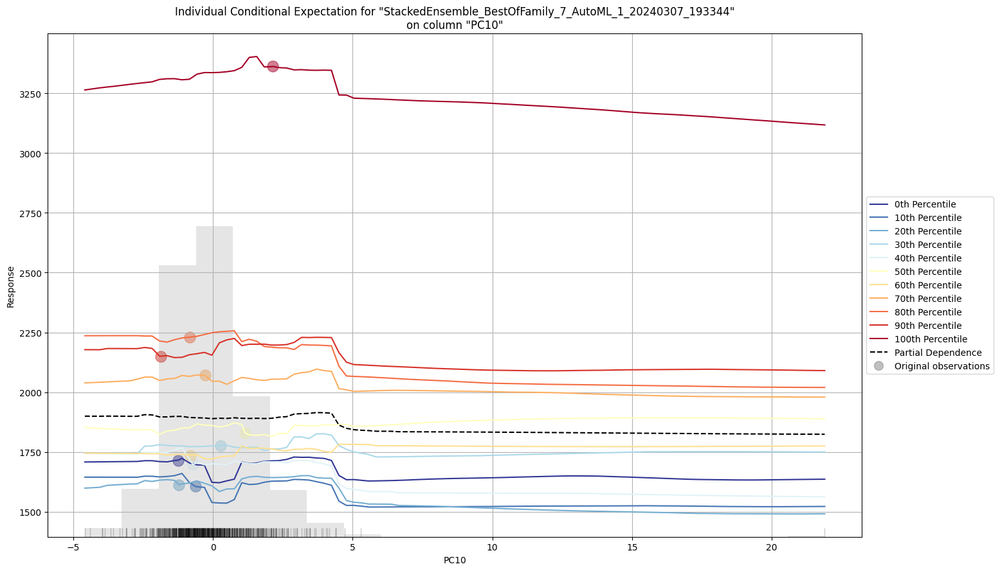

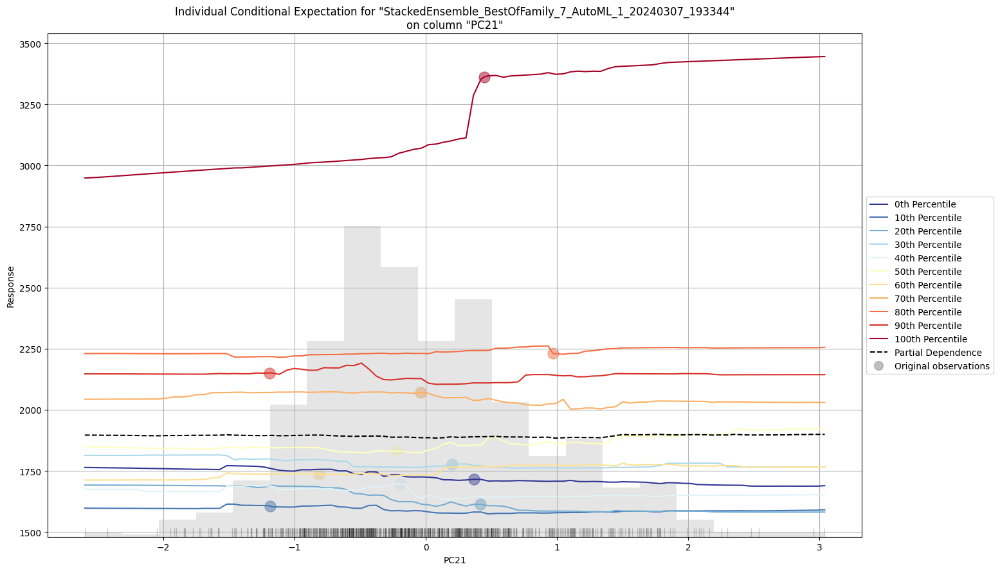

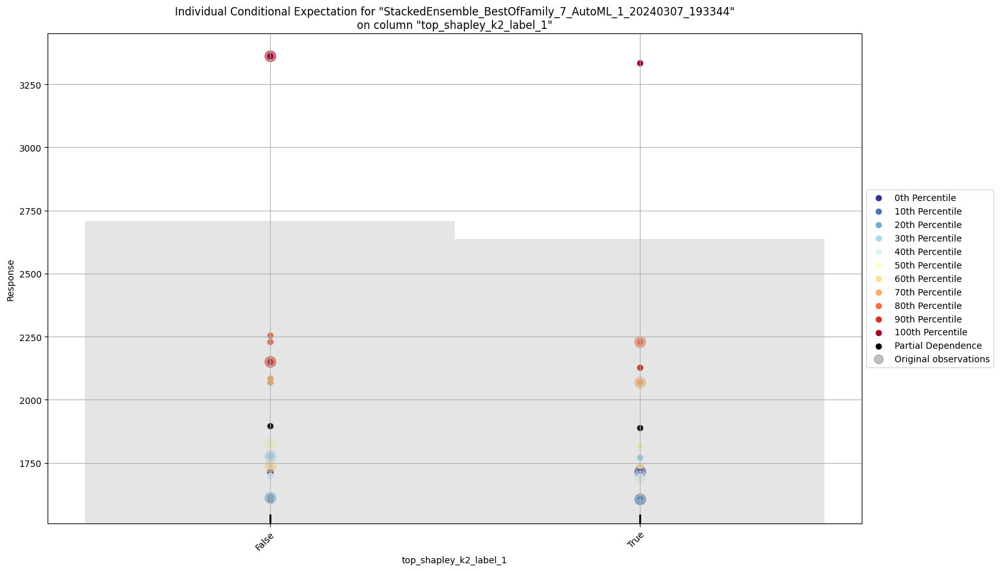

In [19]:
# Explain a single model
exm = aml.leader.explain(h2o_test, top_n_features=10)

# Individual Conditional Expectation

> Individual conditional expectations (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response for a given row. ICE plot is similar to partial dependence plot (PDP), PDP shows the average effect of a feature while ICE plot shows the effect for a single instance.

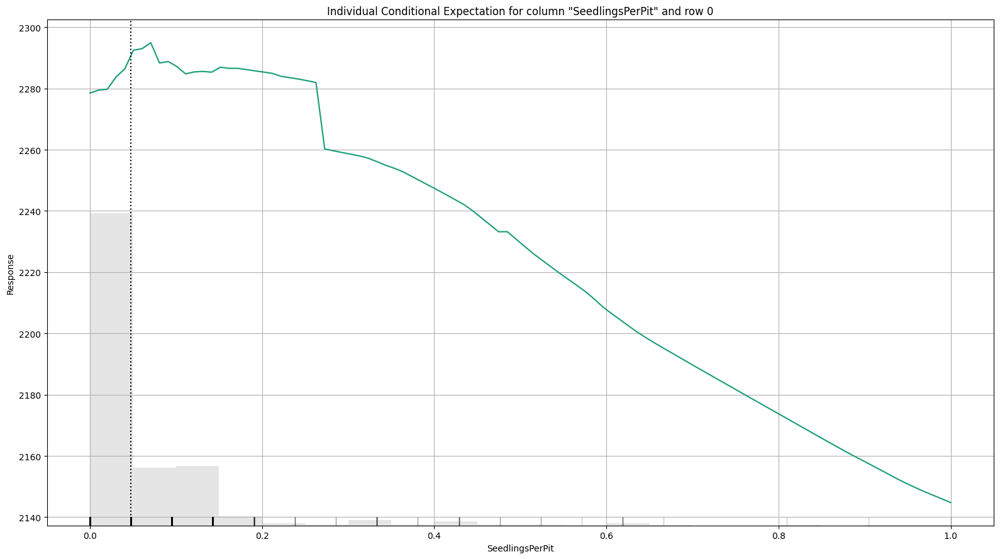

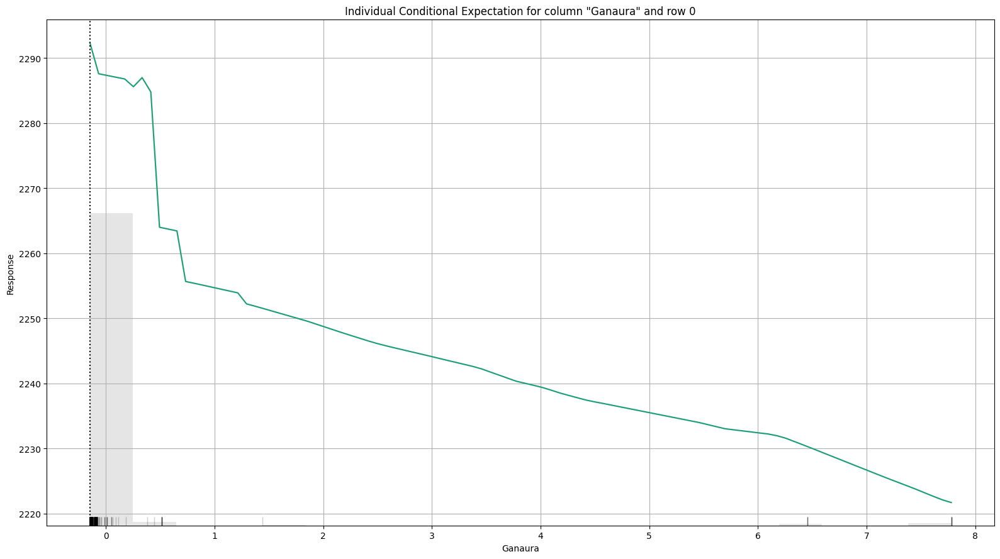

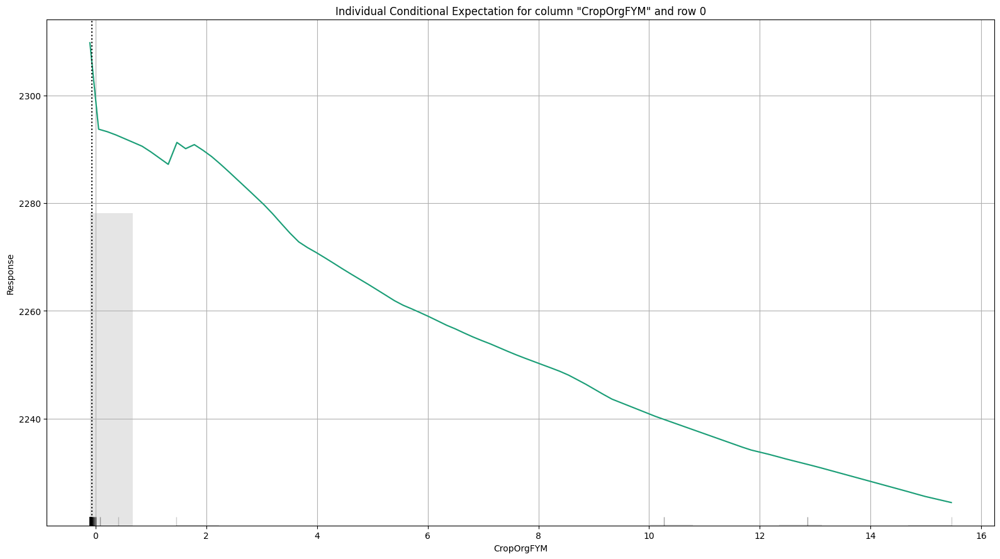

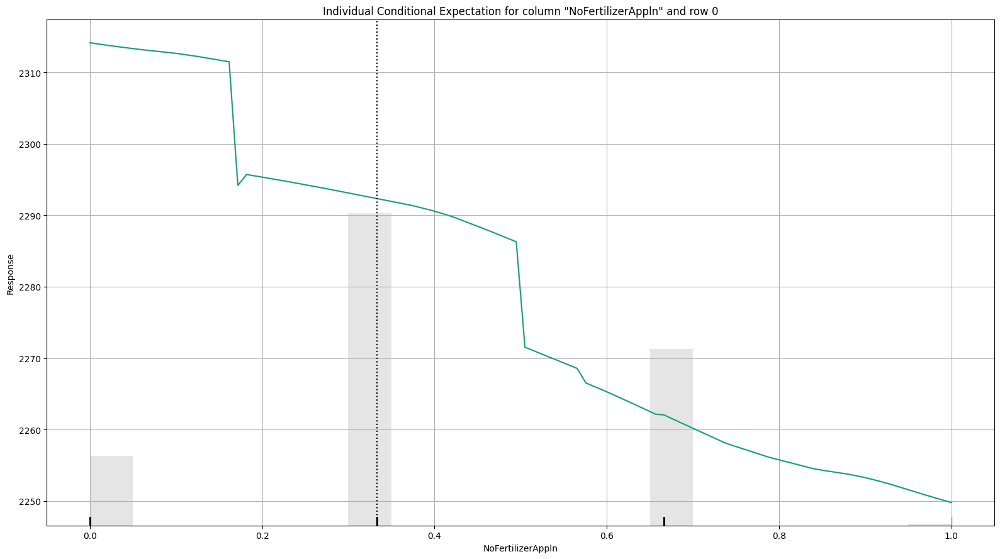

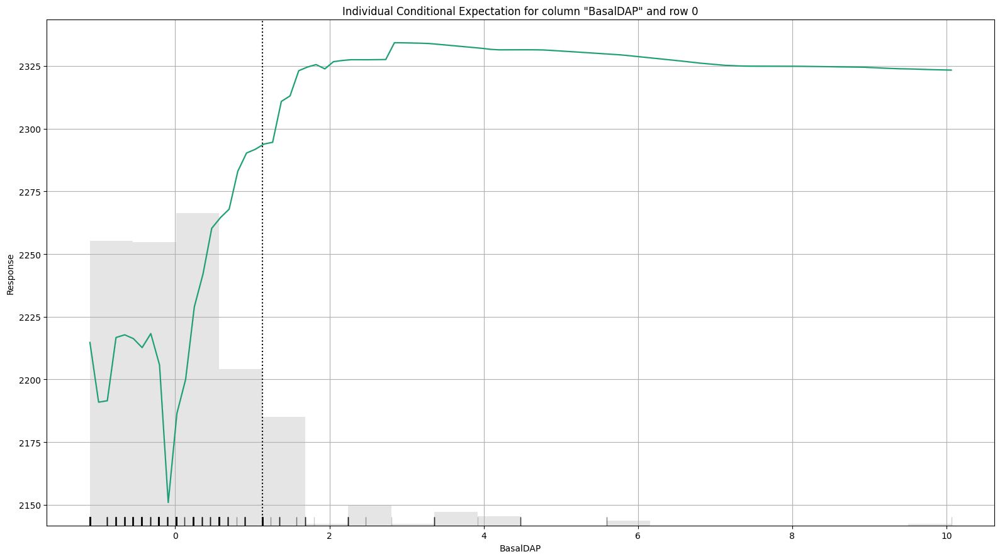

...

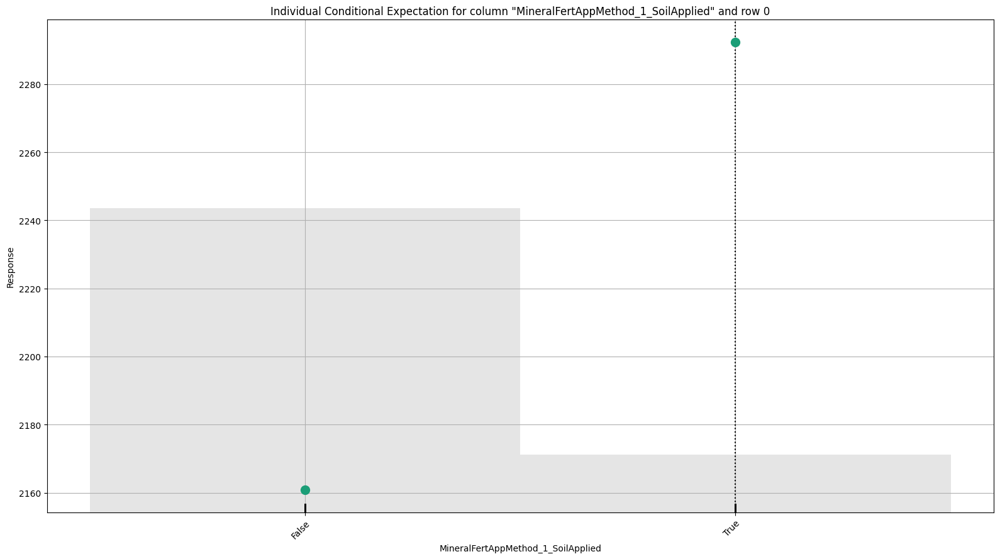

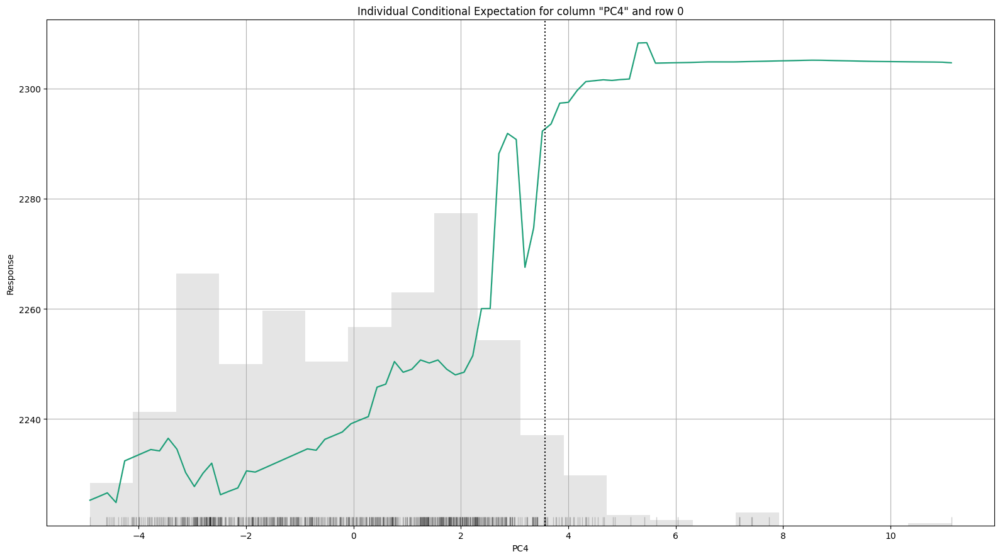

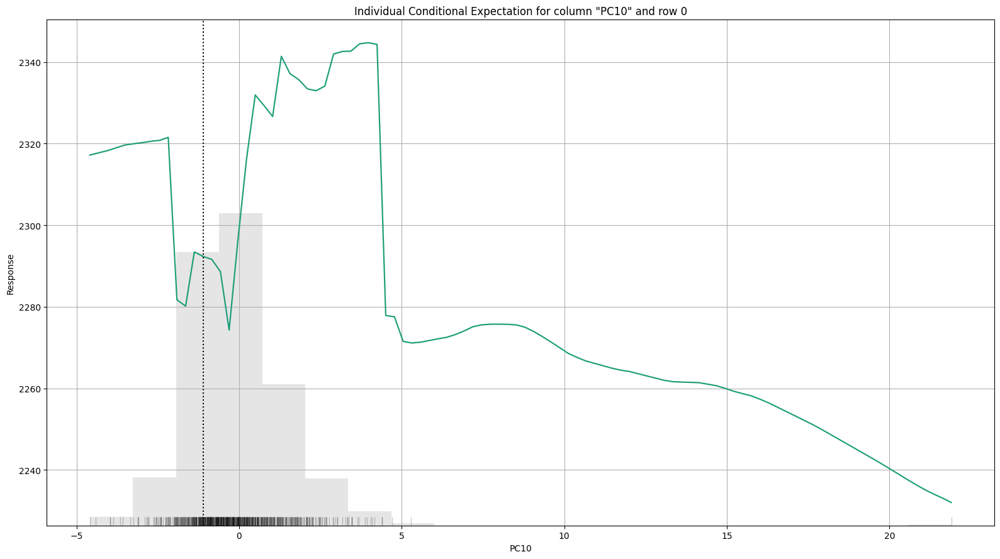

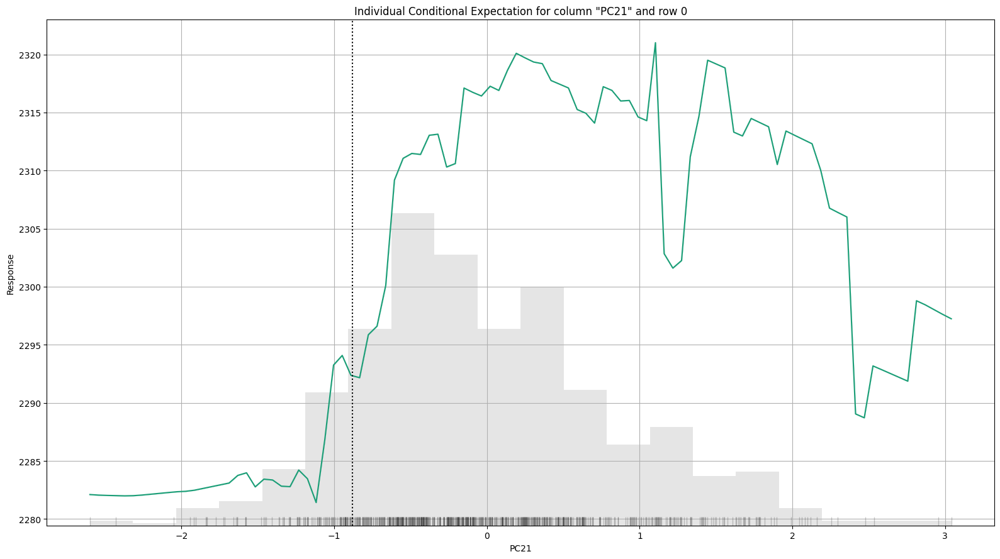

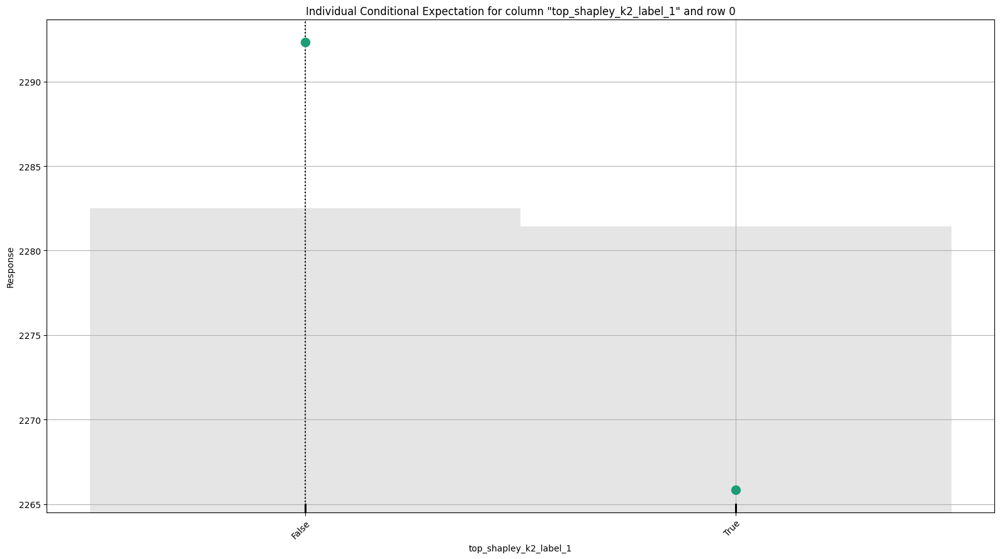

# Individual Conditional Expectation

> Individual conditional expectations (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response for a given row. ICE plot is similar to partial dependence plot (PDP), PDP shows the average effect of a feature while ICE plot shows the effect for a single instance.

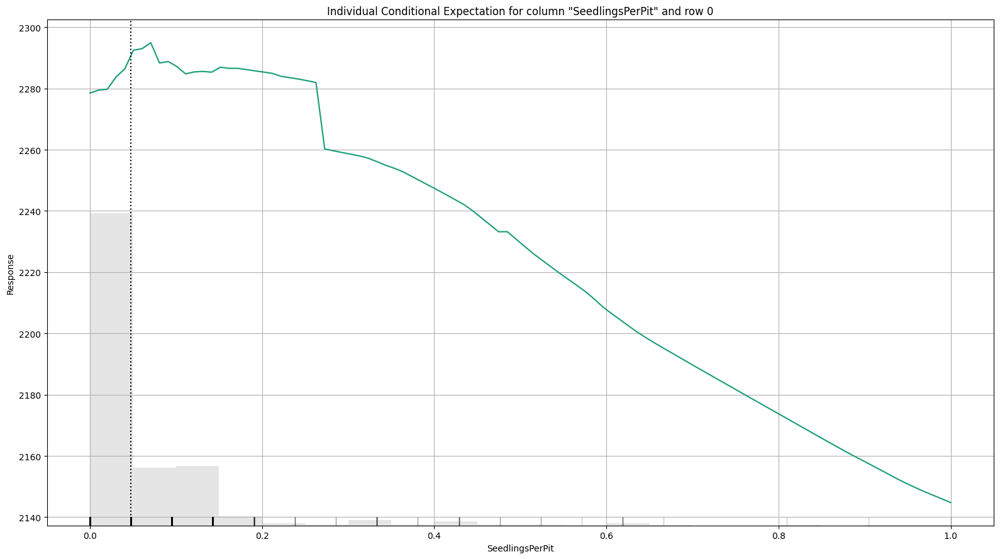

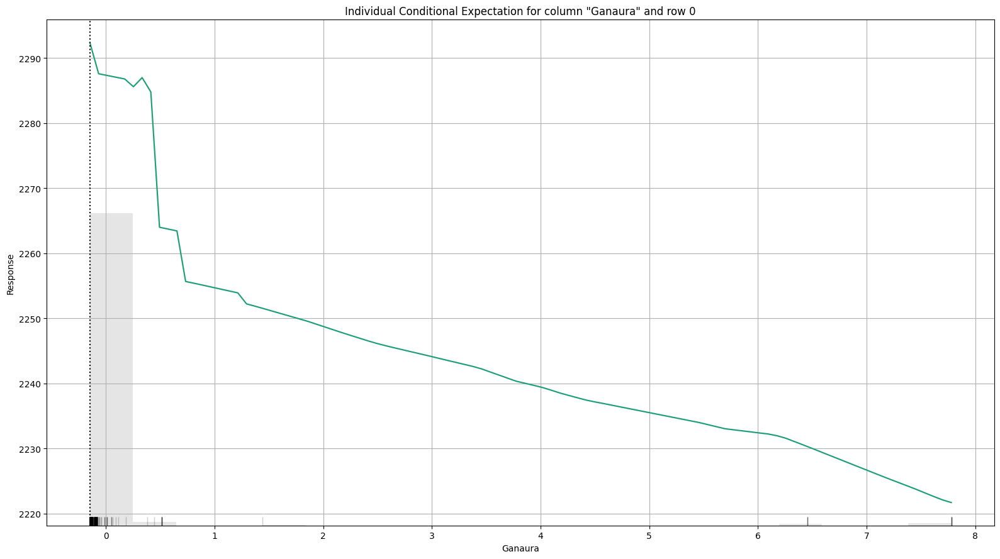

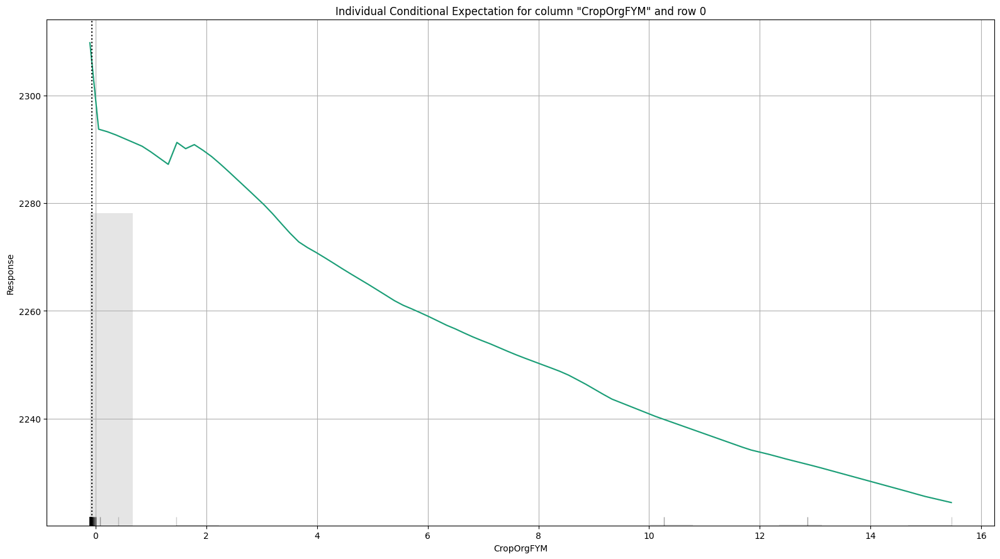

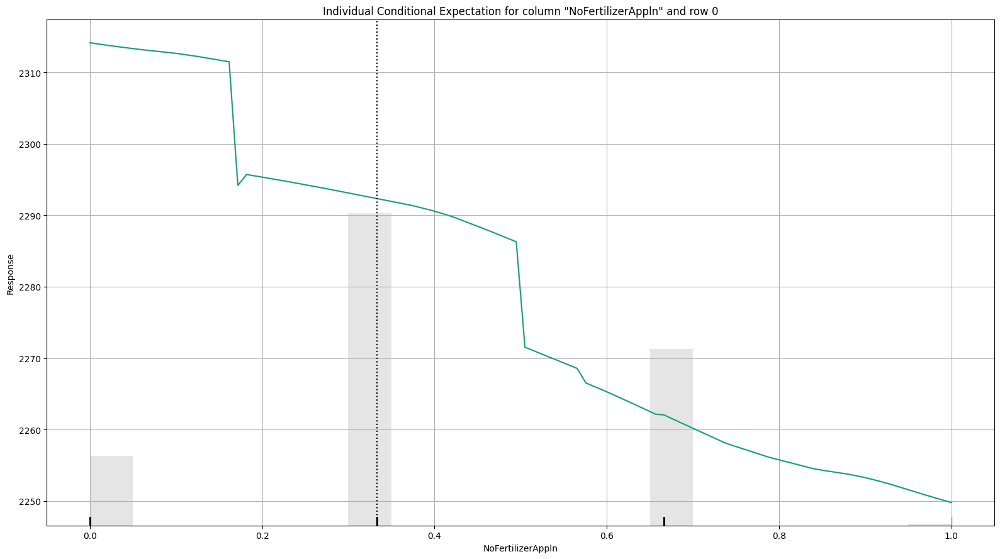

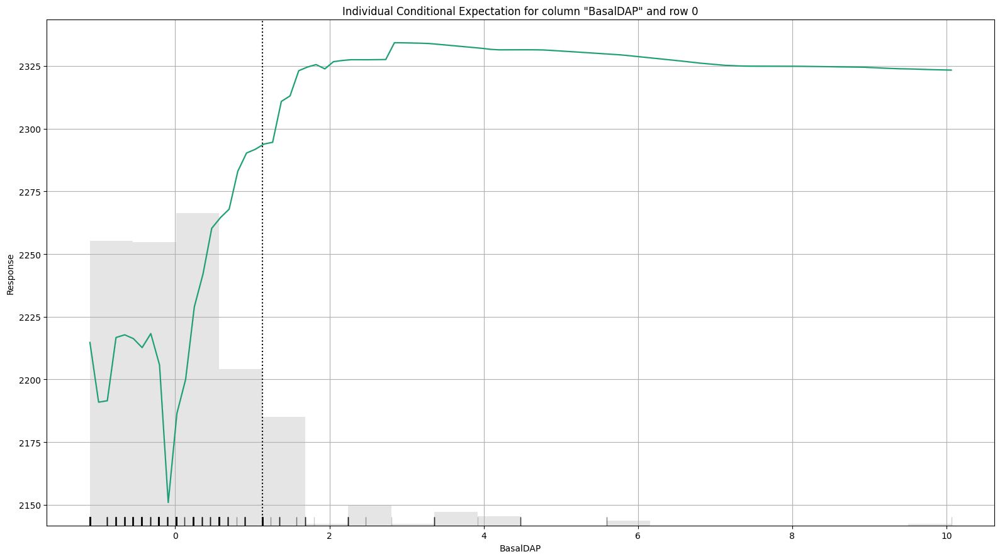

...

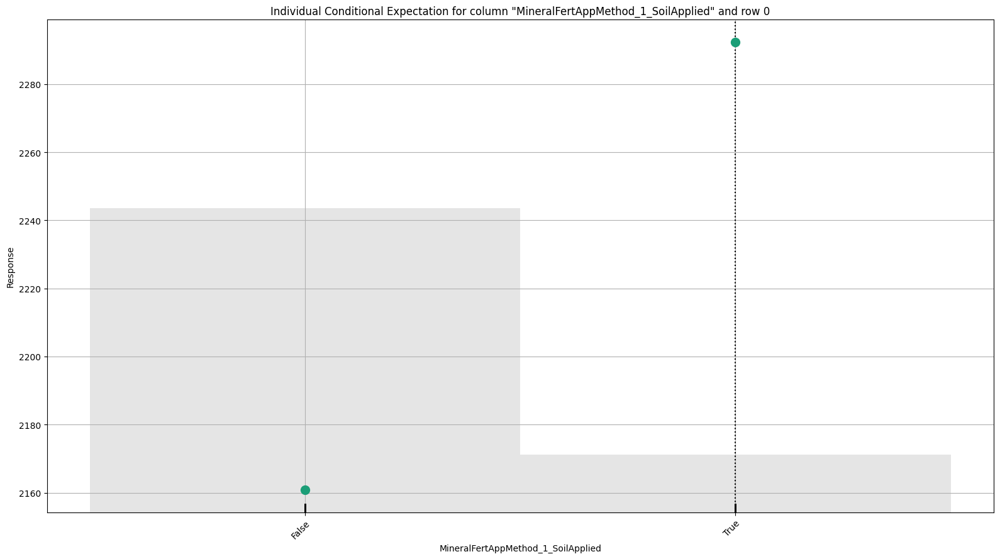

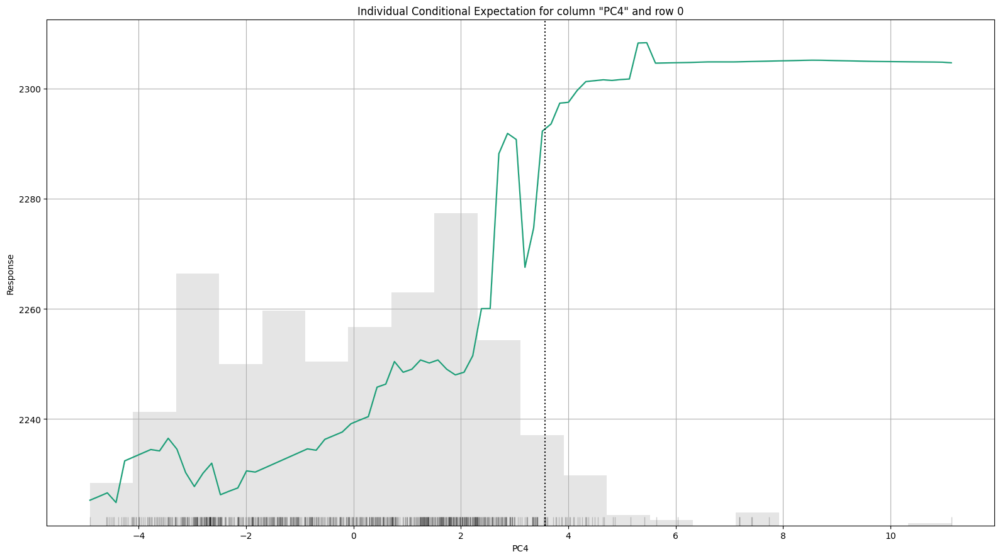

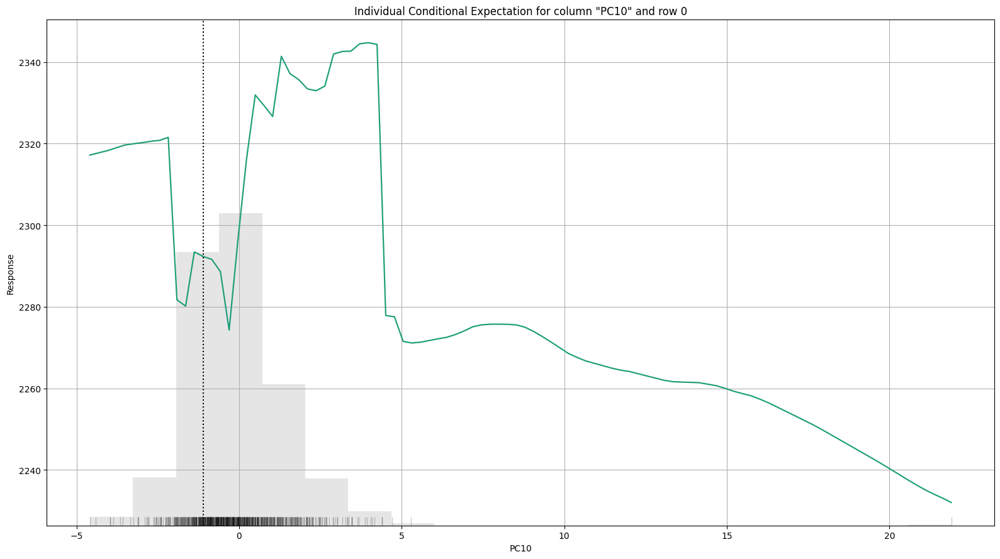

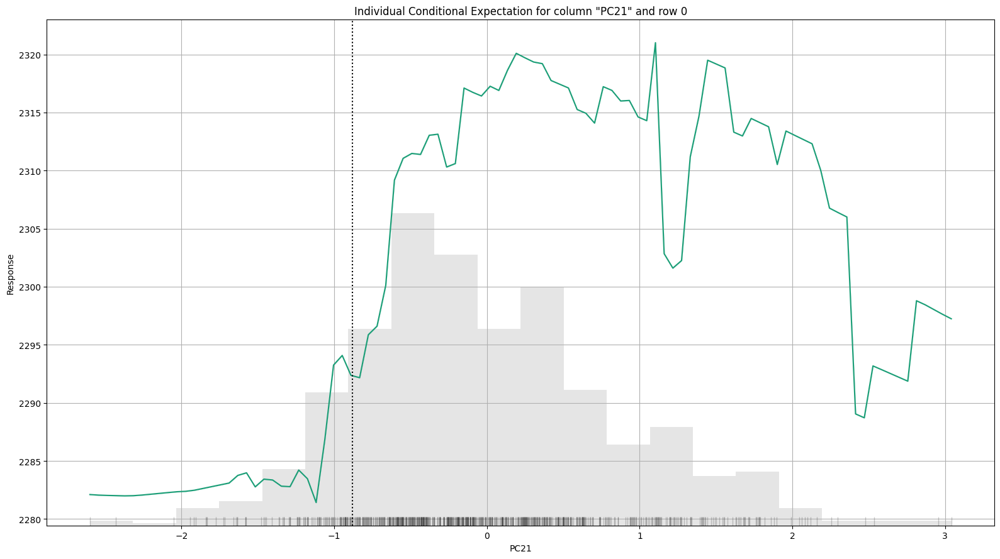

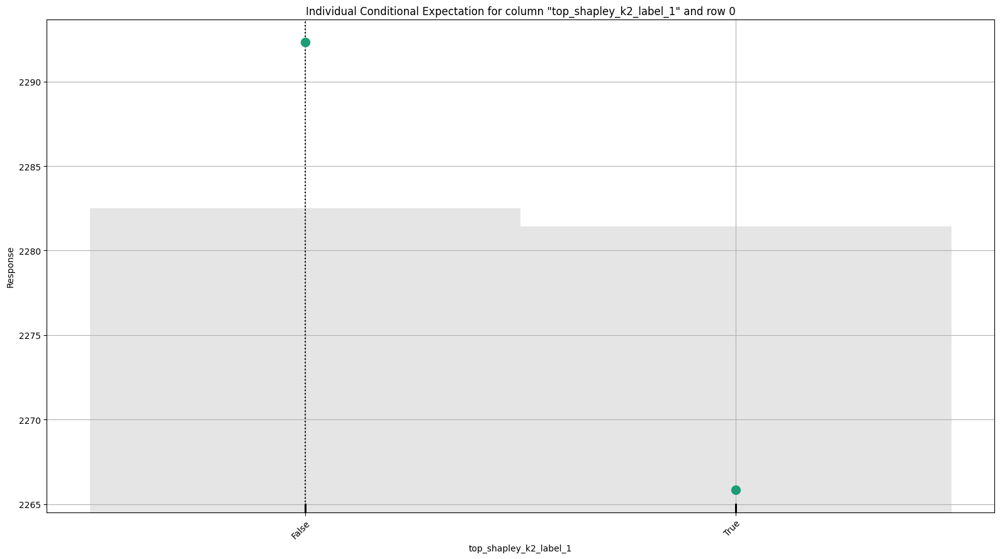

In [22]:
# Explain first row with a single H2O model (e.g. leader model from AutoML)
aml.leader.explain_row(h2o_test, row_index=0, top_n_features=10)

In [23]:
perf = aml.leader.model_performance(h2o_test)
print(perf)

ModelMetricsRegressionGLM: stackedensemble
** Reported on test data. **

MSE: 104496.9068392926
RMSE: 323.2598132142203
MAE: 182.29670294078554
RMSLE: NaN
Mean Residual Deviance: 104496.9068392926
R^2: 0.6258543967208767
Null degrees of freedom: 773
Residual degrees of freedom: 768
Null deviance: 216382001.34754676
Residual deviance: 80880605.89361247
AIC: 11155.567318152329


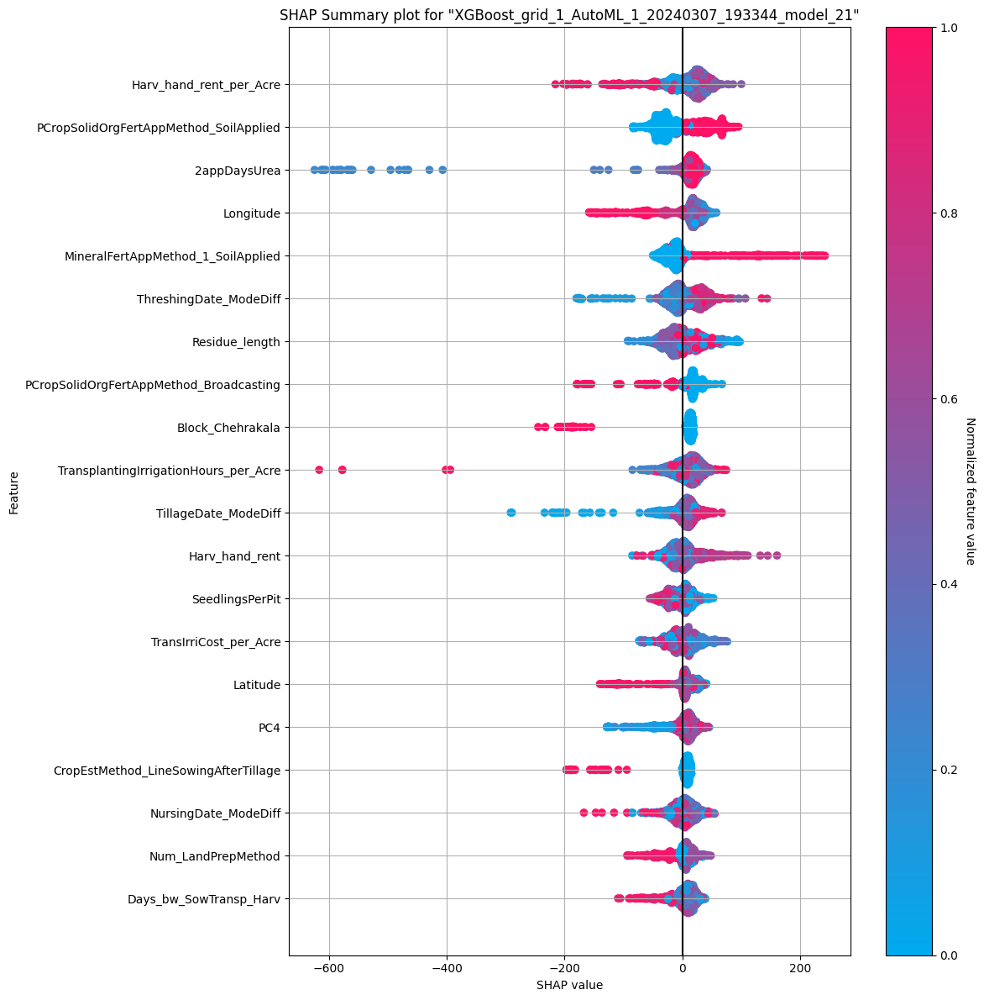

In [31]:
xgb.shap_summary_plot(h2o_test)

In [32]:
# Get leaderboard with all possible columns
lb = h2o.automl.get_leaderboard(aml, extra_columns = "ALL")
lb

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_BestOfFamily_7_AutoML_1_20240307_193344,311.666,97135.6,182.756,nan,97135.6,166,0.019807,StackedEnsemble
StackedEnsemble_AllModels_6_AutoML_1_20240307_193344,311.748,97186.6,182.563,nan,97186.6,579,0.02305,StackedEnsemble
StackedEnsemble_AllModels_4_AutoML_1_20240307_193344,312.534,97677.5,182.497,nan,97677.5,198,0.024919,StackedEnsemble
StackedEnsemble_BestOfFamily_5_AutoML_1_20240307_193344,313.139,98056.3,184.39,nan,98056.3,179,0.019396,StackedEnsemble
StackedEnsemble_BestOfFamily_6_AutoML_1_20240307_193344,313.42,98232.4,184.526,nan,98232.4,383,0.025579,StackedEnsemble
StackedEnsemble_AllModels_5_AutoML_1_20240307_193344,313.464,98259.5,183.237,nan,98259.5,2082,0.062209,StackedEnsemble
StackedEnsemble_AllModels_3_AutoML_1_20240307_193344,313.993,98591.6,186.486,nan,98591.6,186,0.021688,StackedEnsemble
StackedEnsemble_BestOfFamily_4_AutoML_1_20240307_193344,314.578,98959.1,186.778,nan,98959.1,162,0.019348,StackedEnsemble
GBM_lr_annealing_selection_AutoML_1_20240307_193344_select_model,315.248,99381.4,190.783,nan,99381.4,467,0.015371,GBM
StackedEnsemble_AllModels_2_AutoML_1_20240307_193344,316.708,100304,186.404,nan,100304,170,0.019514,StackedEnsemble


model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_3_AutoML_1_20240307_193344,319.757,102244,182.147,nan,102244,186,0.030348,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_1_20240307_193344,320.21,102535,181.887,nan,102535,177,0.021947,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_1_20240307_193344,321.234,103191,183.041,nan,103191,164,0.020173,StackedEnsemble
GBM_2_AutoML_1_20240307_193344,321.585,103417,187.031,nan,103417,277,0.011205,GBM
GBM_3_AutoML_1_20240307_193344,323.128,104411,187.354,0.385995,104411,225,0.010332,GBM
XGBoost_grid_1_AutoML_1_20240307_193344_model_29,326.537,106626,196.877,nan,106626,430,0.002191,XGBoost
XGBoost_grid_1_AutoML_1_20240307_193344_model_23,341.147,116381,202.903,nan,116381,84,0.001868,XGBoost
XGBoost_grid_1_AutoML_1_20240307_193344_model_16,342.489,117298,205.863,nan,117298,78,0.001789,XGBoost
XGBoost_grid_1_AutoML_1_20240307_193344_model_25,351.375,123464,217.368,nan,123464,68,0.001625,XGBoost
GLM_1_AutoML_1_20240307_193344,422.013,178095,280.172,0.573357,178095,73,0.00086,GLM


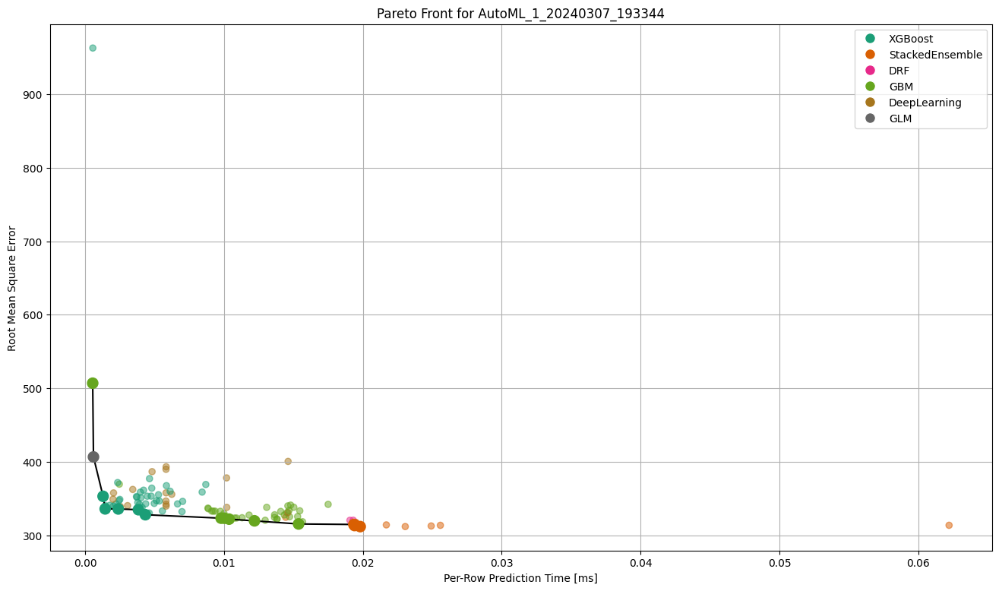

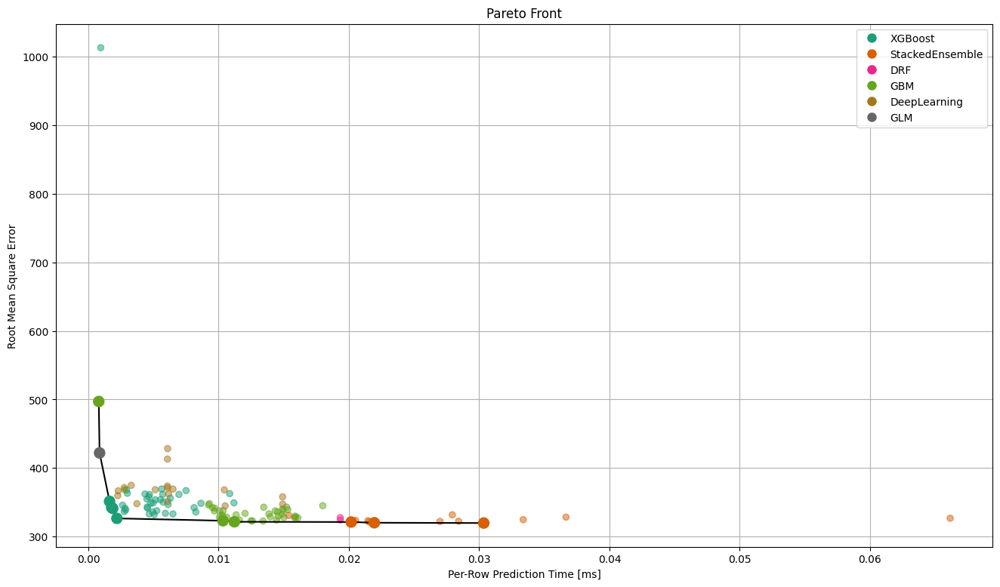

In [33]:
pf = aml.pareto_front()
pf.figure() # get the Pareto front plot
pf # H2OFrame containing the Pareto front subset of the leaderboard

combined_leaderboard = h2o.make_leaderboard([aml, xgb], h2o_test, extra_columns="ALL")
pf = h2o.explanation.pareto_front(combined_leaderboard, x_metric="predict_time_per_row_ms", y_metric="rmse", optimum="bottom left")
pf.figure() # get the Pareto front plot
pf # H2OFrame containing the Pareto front subset of the leaderboard

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_3_AutoML_1_20240307_193344,319.757,102244,182.147,nan,102244,186,0.029052,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_1_20240307_193344,320.21,102535,181.887,nan,102535,177,0.027384,StackedEnsemble


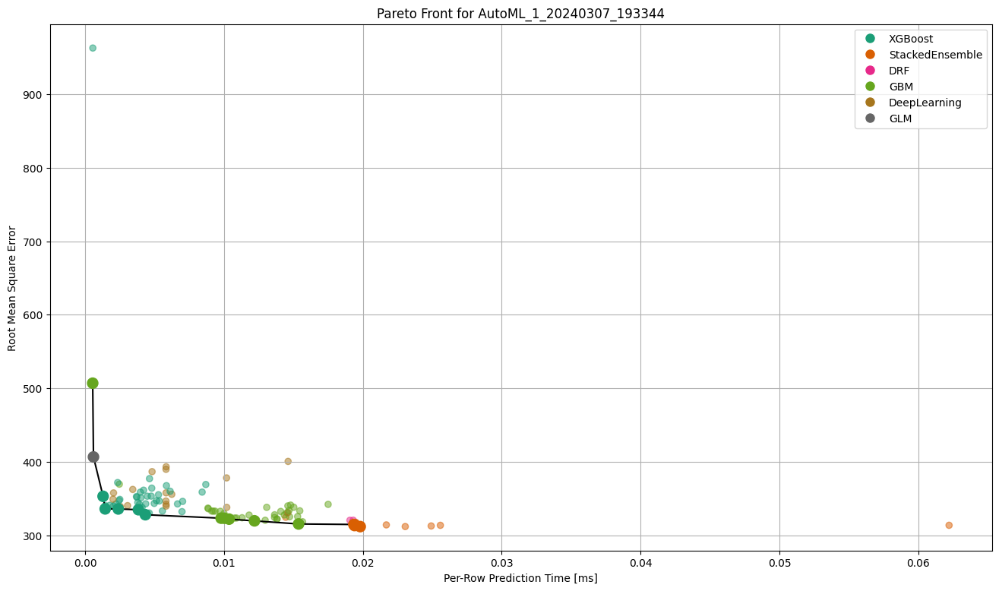

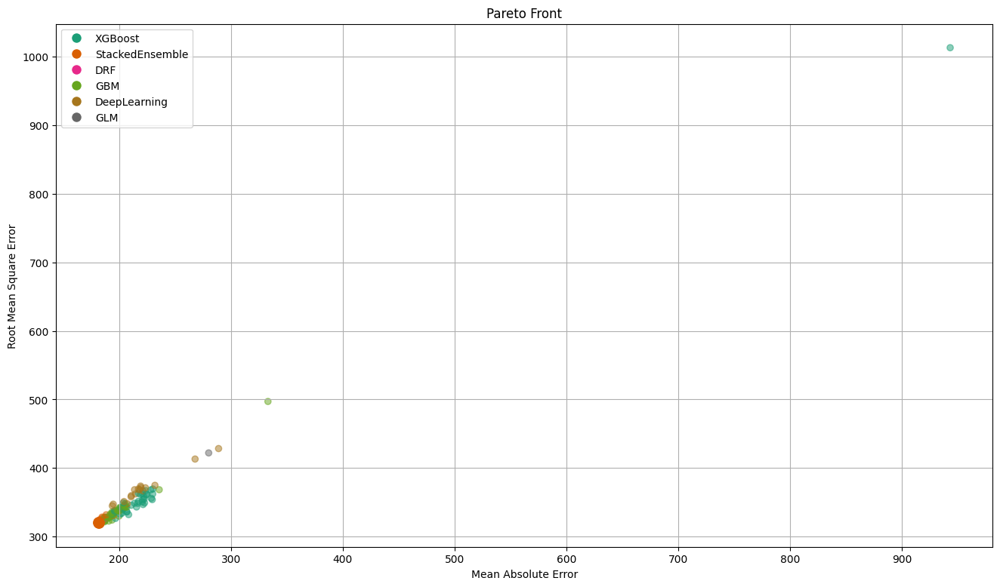

In [35]:
pf = aml.pareto_front()
pf.figure() # get the Pareto front plot
pf # H2OFrame containing the Pareto front subset of the leaderboard

combined_leaderboard = h2o.make_leaderboard([aml], h2o_test, extra_columns="ALL")
pf = h2o.explanation.pareto_front(combined_leaderboard, x_metric="mae", y_metric="rmse", optimum="bottom left")
pf.figure() # get the Pareto front plot
pf # H2OFrame containing the Pareto front subset of the leaderboard

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_3_AutoML_1_20240307_193344,319.757,102244,182.147,nan,102244,186,0.029052,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_1_20240307_193344,320.21,102535,181.887,nan,102535,177,0.027384,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_1_20240307_193344,321.234,103191,183.041,nan,103191,164,0.021618,StackedEnsemble
GBM_2_AutoML_1_20240307_193344,321.585,103417,187.031,nan,103417,277,0.011293,GBM
GBM_3_AutoML_1_20240307_193344,323.128,104411,187.354,0.385995,104411,225,0.010483,GBM
XGBoost_grid_1_AutoML_1_20240307_193344_model_29,326.537,106626,196.877,nan,106626,430,0.002191,XGBoost
XGBoost_grid_1_AutoML_1_20240307_193344_model_23,341.147,116381,202.903,nan,116381,84,0.001913,XGBoost
XGBoost_grid_1_AutoML_1_20240307_193344_model_16,342.489,117298,205.863,nan,117298,78,0.001842,XGBoost
XGBoost_grid_1_AutoML_1_20240307_193344_model_25,351.375,123464,217.368,nan,123464,68,0.001701,XGBoost
GLM_1_AutoML_1_20240307_193344,422.013,178095,280.172,0.573357,178095,73,0.001521,GLM


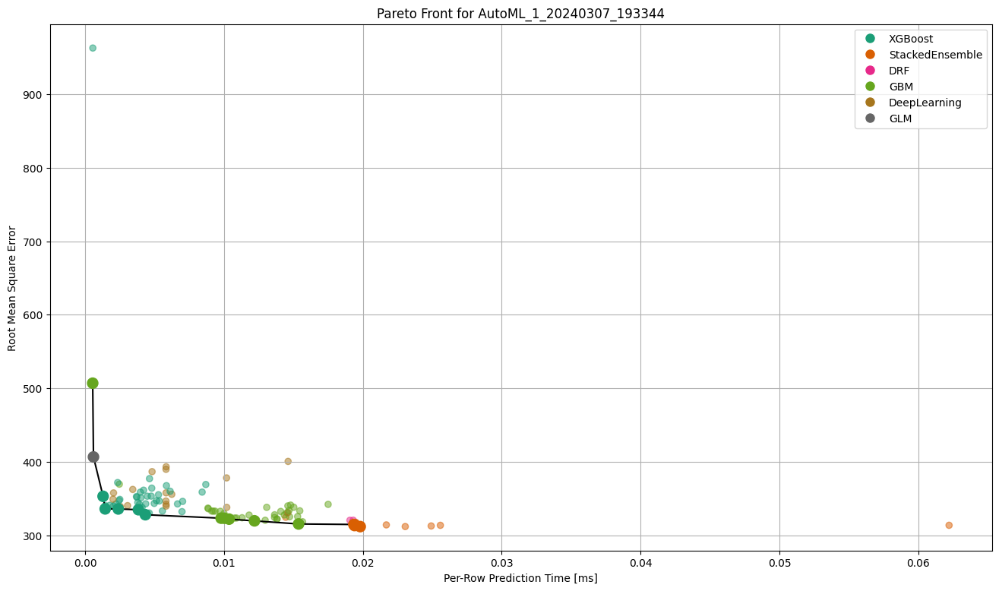

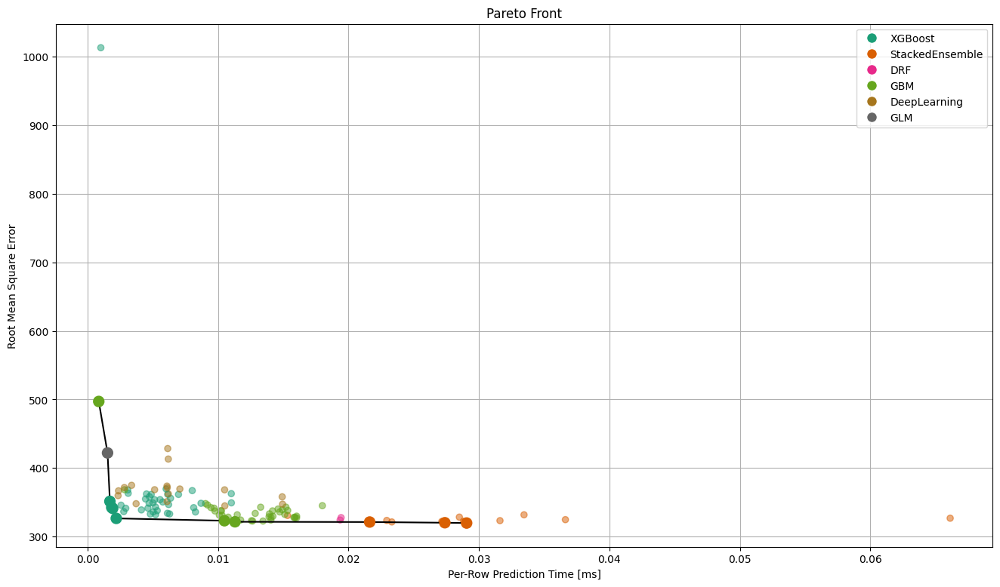

In [38]:
pf = aml.pareto_front()
pf.figure() # get the Pareto front plot
pf # H2OFrame containing the Pareto front subset of the leaderboard

combined_leaderboard = h2o.make_leaderboard([aml], h2o_test, extra_columns="ALL")
pf = h2o.explanation.pareto_front(combined_leaderboard, x_metric="predict_time_per_row_ms", y_metric="rmse", optimum="bottom left")
pf.figure() # get the Pareto front plot
pf # H2OFrame containing the Pareto front subset of the leaderboard

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_3_AutoML_1_20240307_193344,319.757,102244,182.147,nan,102244,186,0.029052,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_1_20240307_193344,320.21,102535,181.887,nan,102535,177,0.027384,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_1_20240307_193344,321.234,103191,183.041,nan,103191,164,0.021618,StackedEnsemble
GBM_2_AutoML_1_20240307_193344,321.585,103417,187.031,nan,103417,277,0.011293,GBM
GBM_3_AutoML_1_20240307_193344,323.128,104411,187.354,0.385995,104411,225,0.010483,GBM
XGBoost_grid_1_AutoML_1_20240307_193344_model_29,326.537,106626,196.877,nan,106626,430,0.002191,XGBoost
XGBoost_grid_1_AutoML_1_20240307_193344_model_23,341.147,116381,202.903,nan,116381,84,0.001913,XGBoost
XGBoost_grid_1_AutoML_1_20240307_193344_model_16,342.489,117298,205.863,nan,117298,78,0.001842,XGBoost
XGBoost_grid_1_AutoML_1_20240307_193344_model_25,351.375,123464,217.368,nan,123464,68,0.001701,XGBoost
GLM_1_AutoML_1_20240307_193344,422.013,178095,280.172,0.573357,178095,73,0.001521,GLM


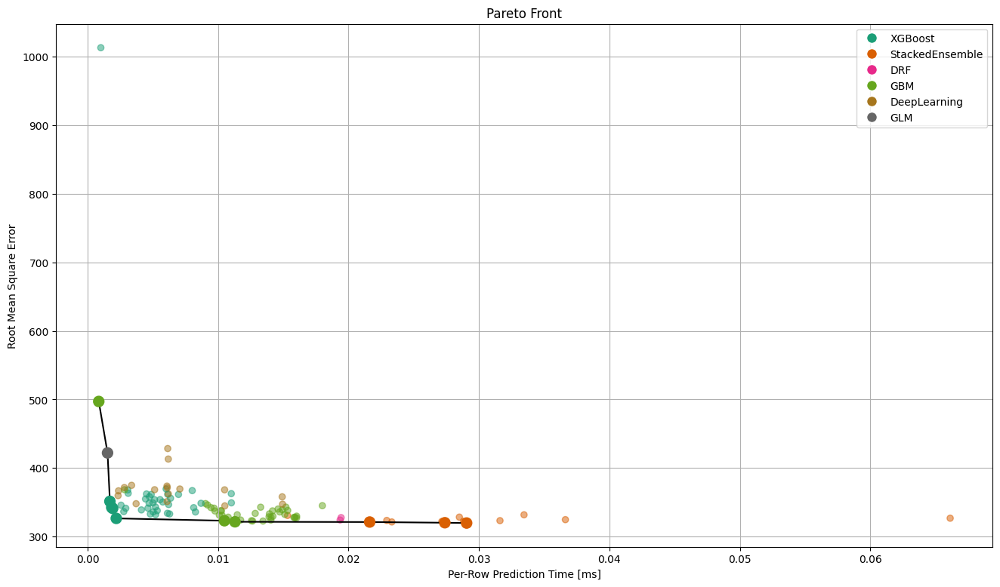

In [42]:
combined_leaderboard = h2o.make_leaderboard([aml], h2o_test, extra_columns="ALL")
pf = h2o.explanation.pareto_front(combined_leaderboard, x_metric="predict_time_per_row_ms", y_metric="rmse", optimum="bottom left")
pf.figure() # get the Pareto front plot
pf # H2OFrame containing the Pareto front subset of the leaderboard